**3D SCENCE RECONSTRUCTION AND NOVEL VIEW RENDERING WITH NERF (NEURAL RADIANCE FIELDS)**

In [ ]:
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import time
import gdown

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


**POSITIONAL ENCODING**

In [ ]:
def positional_encoding(x, num_frequencies, incl_input=True):

    """
    Apply positional encoding to the input.

    Args:
    x (torch.Tensor): Input tensor to be positionally encoded.
      The dimension of x is [N, D], where N is the number of input coordinates,
      and D is the dimension of the input coordinate.
    num_frequencies (optional, int): The number of frequencies used in
     the positional encoding (default: 6).
    incl_input (optional, bool): If True, concatenate the input with the
        computed positional encoding (default: True).

    Returns:
    (torch.Tensor): Positional encoding of the input tensor.
    """

    results = []
    if incl_input:
        results.append(x)
    # encode input tensor and append the encoded tensor to the list of results.
    # num_frequencies corresponds to L in the formula
    for i in range(num_frequencies):
        # Calculate frequency 2^i * pi
        frequency = 2**i * np.pi

        # Apply sin and cos functions element-wise
        sin_encoding = torch.sin(frequency * x)
        cos_encoding = torch.cos(frequency * x)

        # Append to results
        results.extend([sin_encoding, cos_encoding])
    # Ensure num_frequencies is used correctly here
    encoded_tensor = torch.cat(results, dim=-1)
    # Print the output shape for debugging
    #print("Encoded tensor shape:", encoded_tensor.shape)
    return torch.cat(results, dim=-1)

**NORMALIZED COORDINATES & POSITIONAL ENCODING**

In [ ]:
def normalize_coord(height, width, num_frequencies):

    """
    Creates the 2D normalized coordinates, and applies positional encoding to them

    Args:
    height (int): Height of the image
    width (int): Width of the image
    num_frequencies (optional, int): The number of frequencies used in
      the positional encoding (default: 6).

    Returns:
    (torch.Tensor): Returns the 2D normalized coordinates after applying positional encoding to them.
    """


    # Create the 2D normalized coordinates, and apply positional encoding to them

    # Create a range of values for x and y coordinates
    x_range = torch.linspace(0, 1, width, device=device)  # width values between 0 and 1
    y_range = torch.linspace(0, 1, height, device=device) # height values between 0 and 1

    # Create a grid of coordinates using meshgrid
    x_coords, y_coords = torch.meshgrid(x_range, y_range, indexing='xy')

    # Stack the coordinates to get a (height, width, 2) tensor
    coords = torch.stack((x_coords, y_coords), dim=-1)

    # Apply positional encoding to the coordinates
    embedded_coordinates = positional_encoding(coords, num_frequencies=num_frequencies)



    return embedded_coordinates

In [ ]:
import os
import gdown
import numpy as np
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import torch.nn.functional as F
import time

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [ ]:
url = "https://drive.google.com/file/d/13eBK_LWxs4SkruFKH7glKK9jwQU1BkXK/view?usp=sharing"
gdown.download(url=url, output='lego_data.npz', quiet=False, fuzzy=True)

Downloading...
From: https://drive.google.com/uc?id=13eBK_LWxs4SkruFKH7glKK9jwQU1BkXK
To: /content/lego_data.npz
100%|██████████| 12.7M/12.7M [00:00<00:00, 62.8MB/s]


'lego_data.npz'

**Load the data that is comprised by the images, the R and T matrices of each camera position with respect to the world coordinates and the intrinsics parameters K of the camera.**

torch.Size([106, 4, 4])


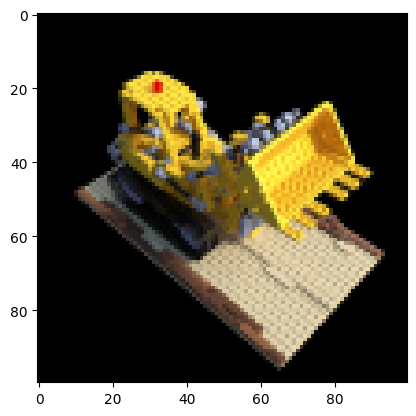

NpzFile 'lego_data.npz' with keys: images, poses, intrinsics


In [ ]:
# Load input images, poses, and intrinsics
data = np.load("lego_data.npz")

# Images
images = data["images"]

# Height and width of each image
height, width = images.shape[1:3]

# Camera extrinsics (poses)
poses = data["poses"]
poses = torch.from_numpy(poses).to(device)
print(poses.shape)

# Camera intrinsics
intrinsics = data["intrinsics"]
intrinsics = torch.from_numpy(intrinsics).to(device)

# Hold one image out (for test).
test_image, test_pose = images[101], poses[101]
test_image = torch.from_numpy(test_image).to(device)

# Map images to device
images = torch.from_numpy(images[:100, ..., :3]).to(device)

plt.imshow(test_image.detach().cpu().numpy())
plt.show()

print(data)

**CALCULATE THE RAYS THAT PASS THROUGH ALL PIXELS OF AN HxW IMAGE**

In [ ]:
def get_rays(height, width, intrinsics, w_R_c, w_T_c):

    """
    Compute the origin and direction of rays passing through all pixels of an image (one ray per pixel).

    Args:
    height: the height of an image.
    width: the width of an image.
    intrinsics: camera intrinsics matrix of shape (3, 3).
    w_R_c: Rotation matrix of shape (3,3) from camera to world coordinates.
    w_T_c: Translation vector of shape (3,1) that transforms

    Returns:
    ray_origins (torch.Tensor): A tensor of shape (height, width, 3) denoting the centers of
      each ray. Note that desipte that all ray share the same origin, here we ask you to return
      the ray origin for each ray as (height, width, 3).
    ray_directions (torch.Tensor): A tensor of shape (height, width, 3) denoting the
      direction of each ray.
    """

    device = intrinsics.device
    ray_directions = torch.zeros((height, width, 3), device=device)  # placeholder
    ray_origins = torch.zeros((height, width, 3), device=device)  # placeholder



    # Create a grid of image coordinates
    i, j = torch.meshgrid(
        torch.arange(width, dtype=torch.float32, device=device),
        torch.arange(height, dtype=torch.float32, device=device),
        indexing='xy'
    )

    # Normalize image coordinates to be in the range [-1, 1]
    dirs = torch.stack([(i - intrinsics[0, 2]) / intrinsics[0, 0],
                        (j - intrinsics[1, 2]) / intrinsics[1, 1],
                        torch.ones_like(i)], -1)

    # Rotate ray directions to world coordinates
    ray_directions = torch.sum(dirs[..., None, :] * w_R_c, -1)

    # Set ray origins to the camera's position in world coordinates
    ray_origins = w_T_c.expand(ray_directions.shape)



    return ray_origins, ray_directions

**VISUALIZE CREATED DATASET**
**WE WANT TO BE ABLE TO INTERPOLATE BETWEEN THESE GIVEN VIEWS AND SYNTHESIZE NEW REALISTIC VIEWS OF THE 3D OBJECT**

Poses:  (106, 4, 4)


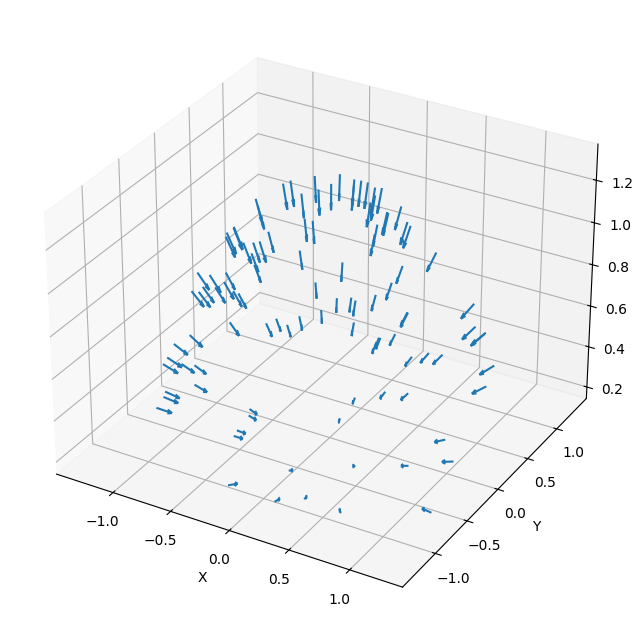

In [ ]:
def plot_all_poses(poses):


    print("Poses: ", poses.shape)
    origins = poses[:, :3, 3]
    directions = poses[:, :3, 2]  # Assuming z-axis points forward




    ax = plt.figure(figsize=(12, 8)).add_subplot(projection='3d')
    _ = ax.quiver(origins[..., 0].flatten(),
                  origins[..., 1].flatten(),
                  origins[..., 2].flatten(),
                  directions[..., 0].flatten(),
                  directions[..., 1].flatten(),
                  directions[..., 2].flatten(), length=0.12, normalize=True)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('z')
    plt.show()

plot_all_poses(data['poses'])

**SAMPLING OF POINTS ALONG A GIVEN RAY**

In [ ]:
def stratified_sampling(ray_origins, ray_directions, near, far, samples):

    """
    Sample 3D points on the given rays. The near and far variables indicate the bounds of sampling range.

    Args:
    ray_origins: Origin of each ray in the "bundle" as returned by the
      get_rays() function. Shape: (height, width, 3).
    ray_directions: Direction of each ray in the "bundle" as returned by the
      get_rays() function. Shape: (height, width, 3).
    near: The 'near' extent of the bounding volume.
    far:  The 'far' extent of the bounding volume.
    samples: Number of samples to be drawn along each ray.

    Returns:
    ray_points: Query 3D points along each ray. Shape: (height, width, samples, 3).
    depth_points: Sampled depth values along each ray. Shape: (height, width, samples).
    """


    # Create a range of depth values (t) between near and far
    t_values = torch.linspace(near, far, samples, device=ray_origins.device)  # on the same device

    # Reshape to allow broadcasting with ray origins and directions
    t_values = t_values.reshape(1, 1, samples, 1).expand(ray_origins.shape[0], ray_origins.shape[1], samples, 1)

    # Calculate 3D points using the formula: point = origin + t * direction
    ray_points = ray_origins[..., None, :] + ray_directions[..., None, :] * t_values

    # depth_points are just the t_values
    depth_points = t_values.squeeze(-1)





    return ray_points, depth_points

**DEVELOP THE NETWORK ARCHITECTURE OF NERF**

In [ ]:
class nerf_model(nn.Module):

    """
    Define a NeRF model comprising eight fully connected layers and following the
    architecture described in the NeRF paper.
    """

    def __init__(self, filter_size=256, num_x_frequencies=10, num_d_frequencies=4):
        super().__init__()
        self.num_x_frequencies = num_x_frequencies
        self.num_d_frequencies = num_d_frequencies


        # Input dimension for positional encoding of positions (x, y, z)
        input_dim_x = 3 + 2 * 3 * num_x_frequencies

        # Input dimension for positional encoding of directions (θ, φ)
        input_dim_d = 3 + 2 * 3 * num_d_frequencies

        print("Input dim d", input_dim_d)
        self.layers = nn.ModuleDict({
            'layer_1': nn.Linear(input_dim_x, filter_size),
            'layer_2': nn.Linear(filter_size, filter_size),
            'layer_3': nn.Linear(filter_size, filter_size),
            'layer_4': nn.Linear(filter_size, filter_size),
            'layer_5': nn.Linear(filter_size, filter_size),
            'layer_6': nn.Linear(filter_size + input_dim_x, filter_size), # Skip connection
            'layer_7': nn.Linear(filter_size, filter_size),
            'layer_8': nn.Linear(filter_size, filter_size), # No activation
            'layer_s': nn.Linear(filter_size, 1),          # Density (sigma)
            'layer_9': nn.Linear(filter_size, filter_size), # Feature vector
            'layer_10': nn.Linear(filter_size + input_dim_d, 128),
            'layer_11': nn.Linear(128, 3),                 # RGB (sigmoid)
        })




    def forward(self, x, d):


        # Positional encoding for positions (x)

        #print("d shape", d)
        #x_encoded = positional_encoding(x, self.num_x_frequencies)
        x_encoded = x

        #print("X_Encoded", x_encoded.shape)

        # Forward pass through layers 1-4
        h = F.relu(self.layers['layer_1'](x_encoded))
        h = F.relu(self.layers['layer_2'](h))
        h = F.relu(self.layers['layer_3'](h))
        h = F.relu(self.layers['layer_4'](h))
        h = F.relu(self.layers['layer_5'](h))

        # Skip connection
        h = torch.cat([h, x_encoded], dim=-1)

        # Forward pass through layers 5-8

        h = F.relu(self.layers['layer_6'](h))
        h = F.relu(self.layers['layer_7'](h))
        h = self.layers['layer_8'](h)  # No activation

        # Density (sigma)
        sigma = F.relu(self.layers['layer_s'](h))

        # Feature vector and positional encoding for directions (d)
        feat = self.layers['layer_9'](h)
        #d_encoded = positional_encoding(d, self.num_d_frequencies)
        d_encoded = d

        # Concatenate feature vector and encoded directions
        h = torch.cat([feat, d_encoded], dim=-1)

        # Forward pass through layers 10-11 to get RGB
        h = F.relu(self.layers['layer_10'](h))
        rgb = torch.sigmoid(self.layers['layer_11'](h))



        return rgb, sigma

**GET BATCHES FUNCTION TO AVOID MEMORY LEAKS**

In [ ]:
def get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies):

    def get_chunks(inputs, chunksize = 2**15):
        """
        This fuction gets an array/list as input and returns a list of chunks of the initial array/list
        """
        return [inputs[i:i + chunksize] for i in range(0, inputs.shape[0], chunksize)]

    """
    This function returns chunks of the ray points and directions to avoid memory errors with the
    neural network. It also applies positional encoding to the input points and directions before
    dividing them into chunks, as well as normalizing and populating the directions.
    """

    # Normalize ray directions
    ray_directions = ray_directions / torch.norm(ray_directions, dim=-1, keepdim=True)

    # Repeat ray directions for each point along the ray
    ray_directions = ray_directions[:, :, None, :].expand(ray_points.shape)

    # Flatten and apply positional encoding to ray points and directions
    ray_points_flat = ray_points.reshape(-1, 3)
    ray_directions_flat = ray_directions.reshape(-1, 3)

    ray_points_encoded = positional_encoding(ray_points_flat, num_x_frequencies)
    ray_directions_encoded = positional_encoding(ray_directions_flat, num_d_frequencies)

    # Divide into chunks
    ray_points_batches = get_chunks(ray_points_encoded)
    ray_directions_batches = get_chunks(ray_directions_encoded)




    return ray_points_batches, ray_directions_batches

**Compute weights for sampled points along rays and use them to reconstruct an RGB image via volumetric rendering.**

In [ ]:
def volumetric_rendering(rgb, s, depth_points):

    """
    Differentiably renders a radiance field, given the origin of each ray in the
    "bundle", and the sampled depth values along them.

    Args:
    rgb: RGB color at each query location (X, Y, Z). Shape: (height, width, samples, 3).
    sigma: Volume density at each query location (X, Y, Z). Shape: (height, width, samples).
    depth_points: Sampled depth values along each ray. Shape: (height, width, samples).

    Returns:
    rec_image: The reconstructed image after applying the volumetric rendering to every pixel.
    Shape: (height, width, 3)
    """


    # For the last sample, use a large value (1e9) to simulate no further points along the ray
    dists = torch.cat([depth_points[..., 1:] - depth_points[..., :-1], torch.tensor([1e9], device=depth_points.device).expand(depth_points[..., :1].shape)], -1)

    # Calculate alpha values (opacity) for each point using the density (sigma) and distance (delta)
    # Apply ReLU to sigma to avoid negative or infinite values
    alpha = 1. - torch.exp(-F.relu(s) * dists)

    # Calculate accumulated transmittance (T_i) for each point along the ray
    # Accumulated transmittance represents the probability of light reaching a point without being blocked by previous points
    T = torch.cumprod(1. - alpha + 1e-10, dim=-1)

    # Shift the transmittance values so that T_i is multiplied by the alpha of the previous point (T_(i-1))
    T = torch.roll(T, 1, dims=-1)
    T[..., 0] = 1.  # Set transmittance at the first point to 1 (no previous points to block light)

    # Calculate the weighted color for each point along the ray using the color (c_i), alpha (1 - exp(-sigma_i * delta_i)), and transmittance (T_i)
    weights = alpha * T

    # Calculate the final color for each ray (pixel) by summing the weighted colors of all points along the ray
    rec_image = torch.sum(weights[..., None] * rgb, -2)



    return rec_image

**Load the sanity_volumentric.pt file and run the volumetric_rendering function to test the volumetric rendering implementation. The expected output should be a sphere on blue background**


In [ ]:
url = "https://drive.google.com/file/d/1ag6MqSh3h4KY10Mcx5fKxt9roGNLLILK/view?usp=sharing"
gdown.download(url=url, output='sanity_volumentric.pt', quiet=False, fuzzy=True)
rbd = torch.load('sanity_volumentric.pt')

Downloading...
From (original): https://drive.google.com/uc?id=1ag6MqSh3h4KY10Mcx5fKxt9roGNLLILK
From (redirected): https://drive.google.com/uc?id=1ag6MqSh3h4KY10Mcx5fKxt9roGNLLILK&confirm=t&uuid=0e5bbaa2-fa71-4a52-b6f9-d2845d554778
To: /content/sanity_volumentric.pt
100%|██████████| 120M/120M [00:01<00:00, 93.5MB/s]
<ipython-input-17-33d38fb278f6>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.

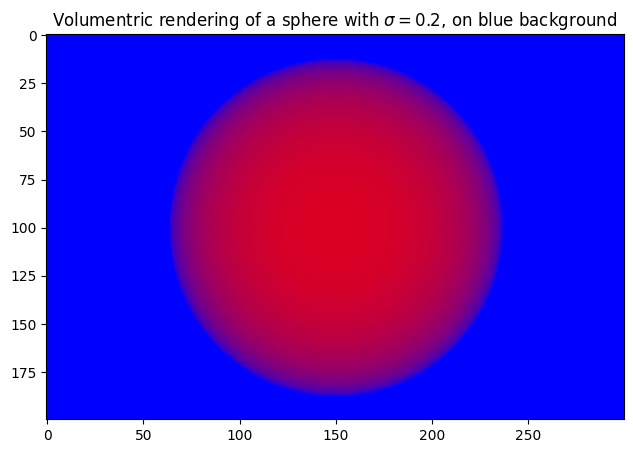

In [ ]:
r = rbd['rgb']
s = rbd['sigma']
depth_points = rbd['depth_points']
rec_image = volumetric_rendering(r, s, depth_points)

plt.figure(figsize=(10, 5))
plt.imshow(rec_image.detach().cpu().numpy())
plt.title(f'Volumentric rendering of a sphere with $\\sigma={0.2}$, on blue background')
plt.show()

**Combine everything together for the forward pass. Given the pose position of a camera, compute the camera rays and sample the 3D points along these rays. Divide those points into batches and feed them to the neural network. Concatenate them and use them for the volumetric rendering to reconstructed the final image.**

In [ ]:
def one_forward_pass(height, width, intrinsics, pose, near, far, samples, model, num_x_frequencies, num_d_frequencies):



    #compute all the rays from the image
    ray_origins, ray_directions = get_rays(height, width, intrinsics, pose[:3, :3], pose[:3, 3])

    #sample the points from the rays
    ray_points, depth_points = stratified_sampling(ray_origins, ray_directions, near, far, samples)

    #divide data into batches to avoid memory errors
    ray_points_batches, ray_directions_batches = get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies)

    #forward pass the batches and concatenate the outputs at the end
    rgb_batches = []
    sigma_batches = []
    for ray_points_batch, ray_directions_batch in zip(ray_points_batches, ray_directions_batches):
        rgb_batch, sigma_batch = model(ray_points_batch, ray_directions_batch)
        rgb_batches.append(rgb_batch)
        sigma_batches.append(sigma_batch)

    rgb = torch.cat(rgb_batches, dim=0)
    sigma = torch.cat(sigma_batches, dim=0)

    # Reshape rgb and sigma to match the original dimensions
    rgb = rgb.reshape(height, width, samples, 3)
    sigma = sigma.reshape(height, width, samples)

    # Apply volumetric rendering to obtain the reconstructed image
    rec_image = volumetric_rendering(rgb, sigma, depth_points)




    return rec_image

**TRAIN NERF MODEL**

In [ ]:
num_x_frequencies = 10
num_d_frequencies = 4
learning_rate  = 5e-4
iterations = 3000
samples = 64
display = 25
near = 0.667
far = 2

model = nerf_model(num_x_frequencies=num_x_frequencies,num_d_frequencies=num_d_frequencies).to(device)

def weights_init(m):
    if isinstance(m, torch.nn.Linear):
        torch.nn.init.xavier_uniform_(m.weight)
model.apply(weights_init)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

#optimizer = torch.optim.SGD(model.parameters(), lr=learning_rate, momentum=0.9, nesterov=True)

psnrs = []
iternums = []

t = time.time()
t0 = time.time()

Input dim d 27


Iteration 0  Loss: 0.1542  PSNR: 8.12  Time: 0.06 secs per iter,  0.03 mins in total


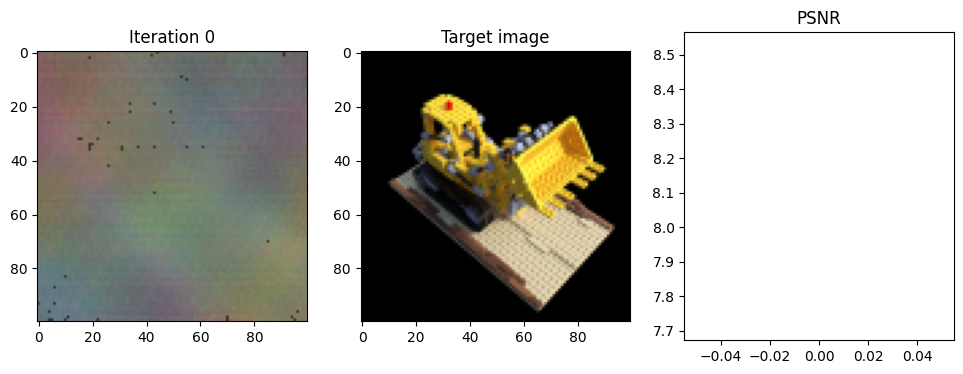

Iteration 25  Loss: 0.0816  PSNR: 10.88  Time: 0.87 secs per iter,  0.39 mins in total


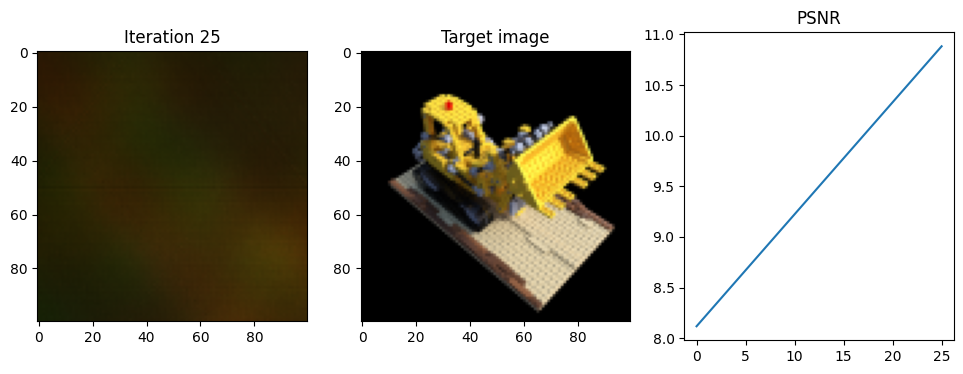

Iteration 50  Loss: 0.0685  PSNR: 11.64  Time: 0.90 secs per iter,  0.77 mins in total


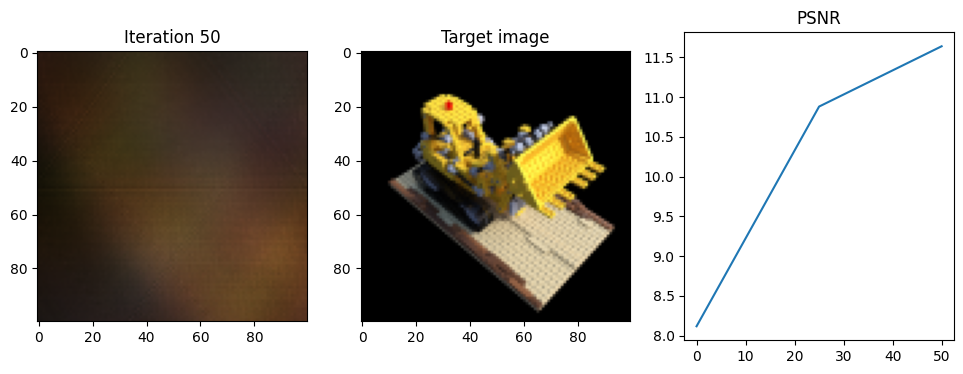

Iteration 75  Loss: 0.0494  PSNR: 13.06  Time: 0.91 secs per iter,  1.15 mins in total


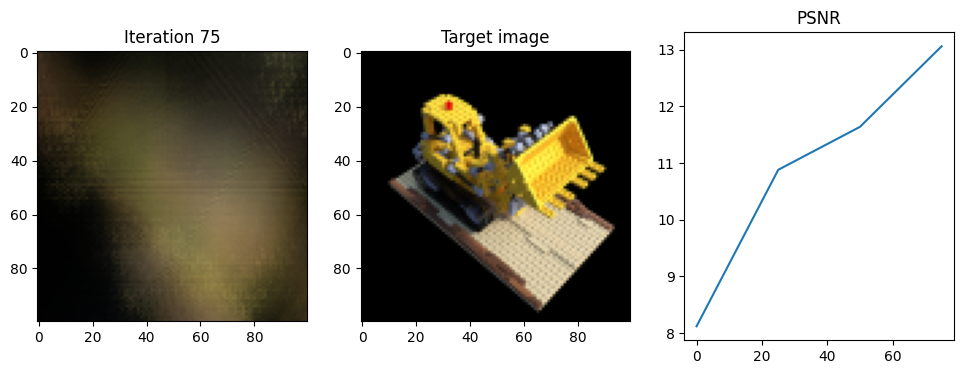

Iteration 100  Loss: 0.0324  PSNR: 14.90  Time: 0.93 secs per iter,  1.53 mins in total


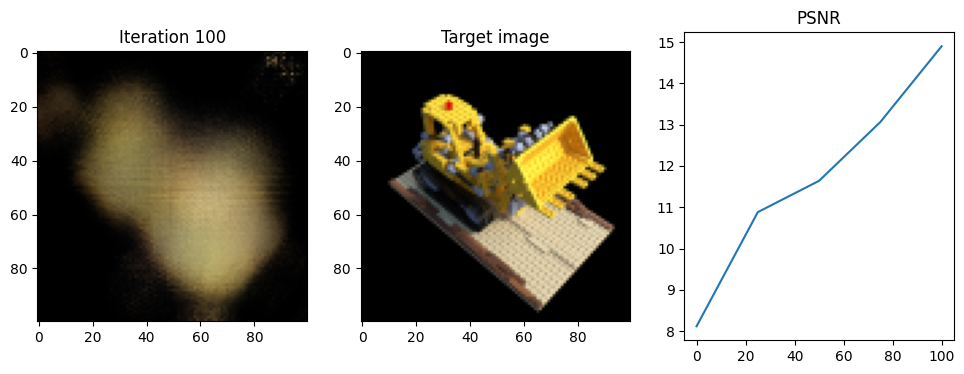

Iteration 125  Loss: 0.0277  PSNR: 15.58  Time: 0.92 secs per iter,  1.92 mins in total


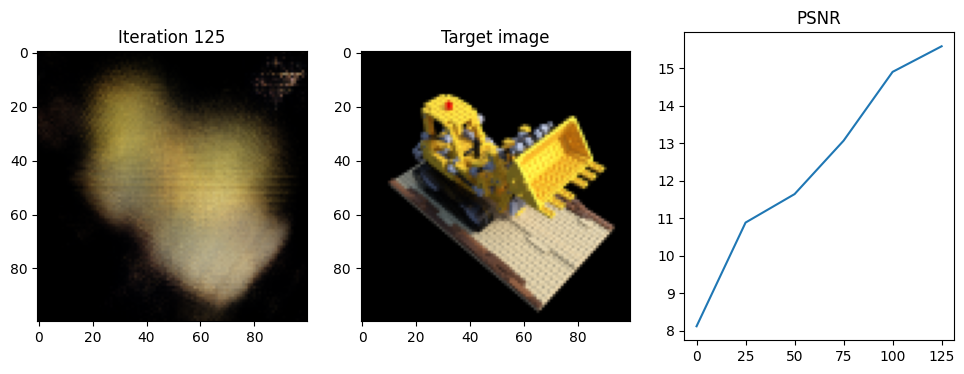

Iteration 150  Loss: 0.0221  PSNR: 16.55  Time: 0.93 secs per iter,  2.31 mins in total


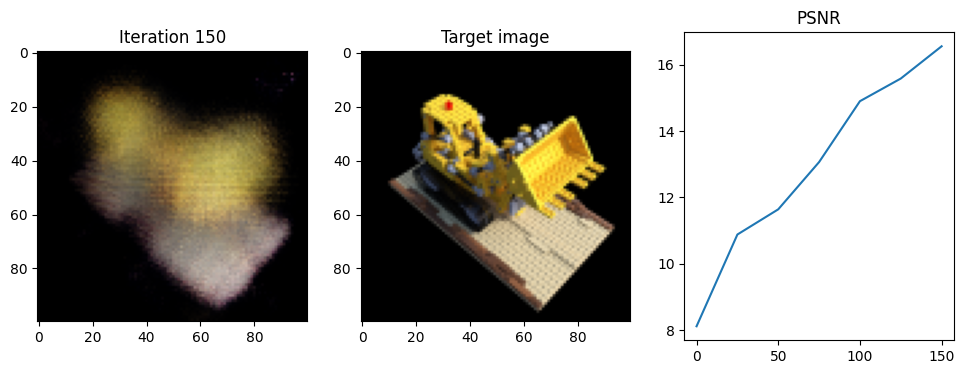

Iteration 175  Loss: 0.0218  PSNR: 16.61  Time: 0.94 secs per iter,  2.70 mins in total


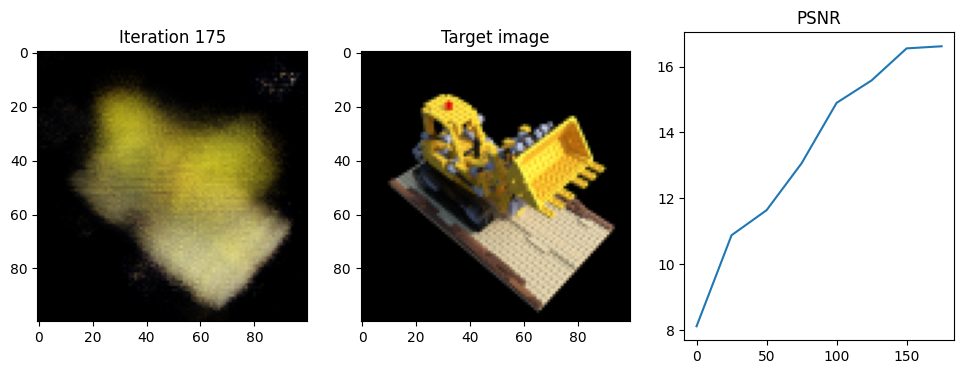

Iteration 200  Loss: 0.0170  PSNR: 17.69  Time: 0.93 secs per iter,  3.08 mins in total


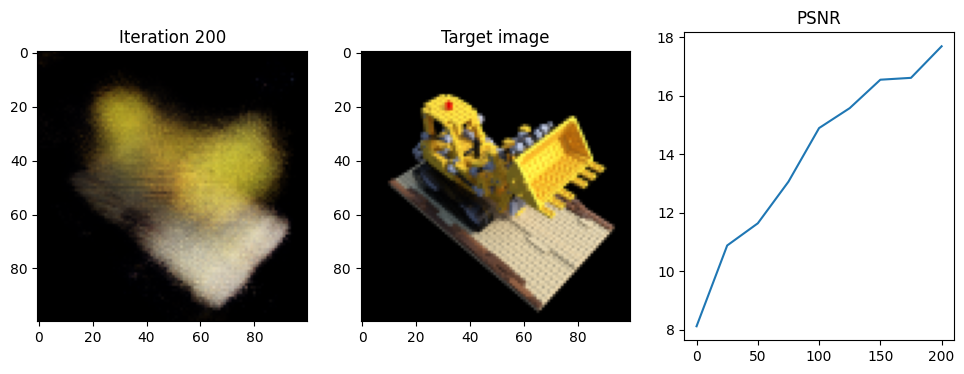

Iteration 225  Loss: 0.0212  PSNR: 16.74  Time: 0.92 secs per iter,  3.47 mins in total


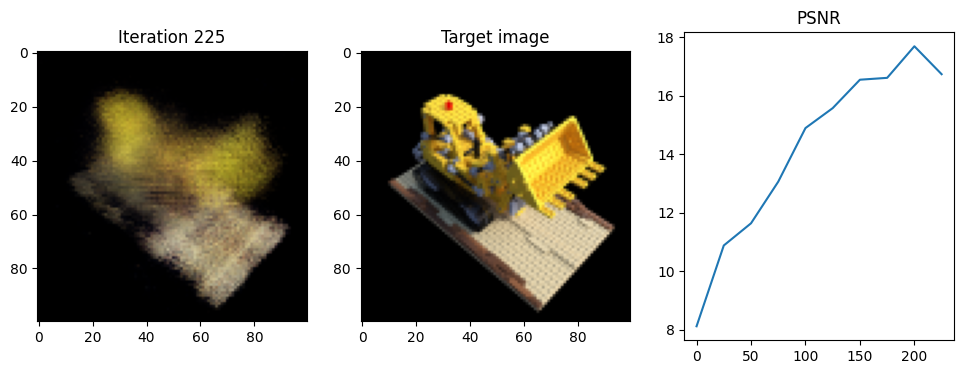

Iteration 250  Loss: 0.0156  PSNR: 18.06  Time: 0.92 secs per iter,  3.85 mins in total


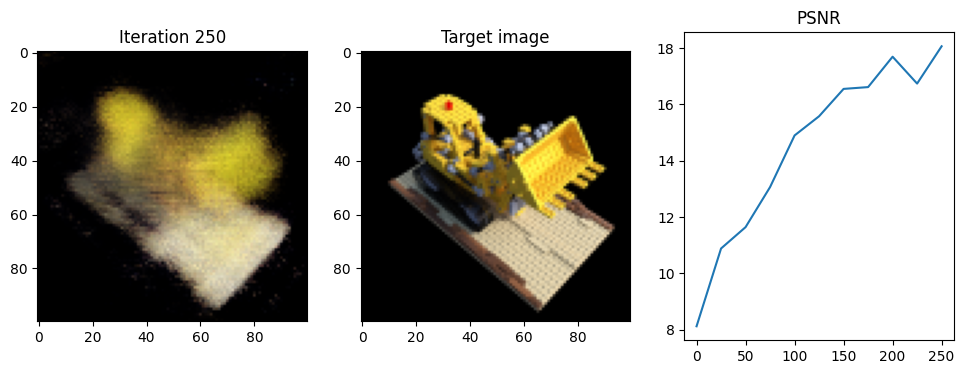

Iteration 275  Loss: 0.0129  PSNR: 18.90  Time: 0.92 secs per iter,  4.24 mins in total


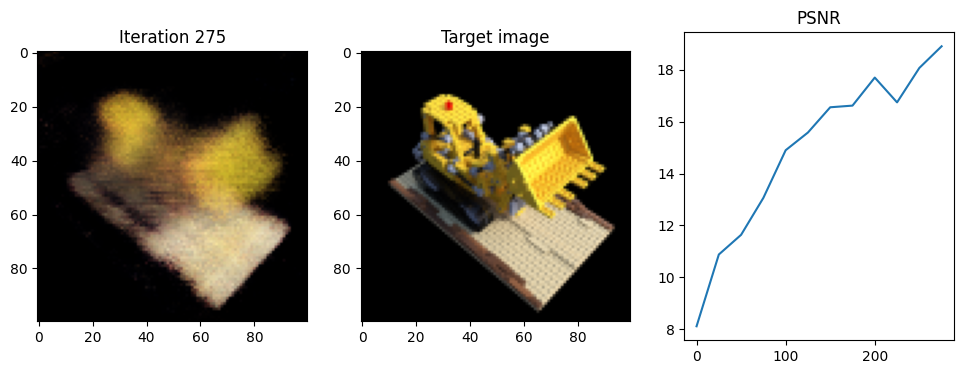

Iteration 300  Loss: 0.0129  PSNR: 18.91  Time: 0.91 secs per iter,  4.62 mins in total


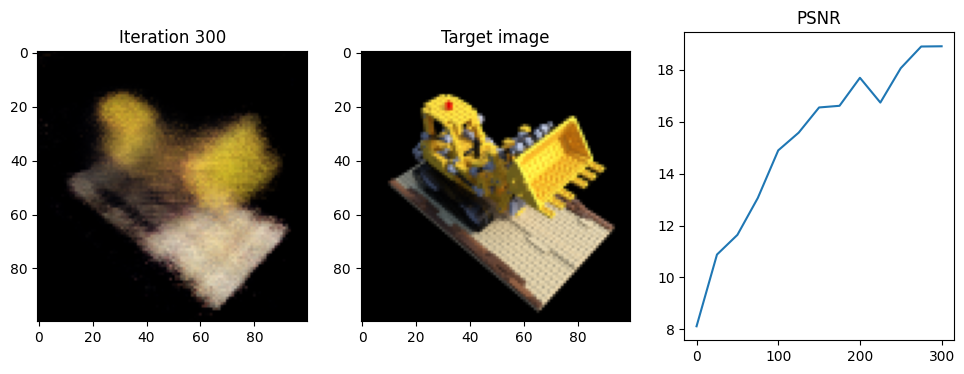

Iteration 325  Loss: 0.0121  PSNR: 19.16  Time: 0.91 secs per iter,  5.00 mins in total


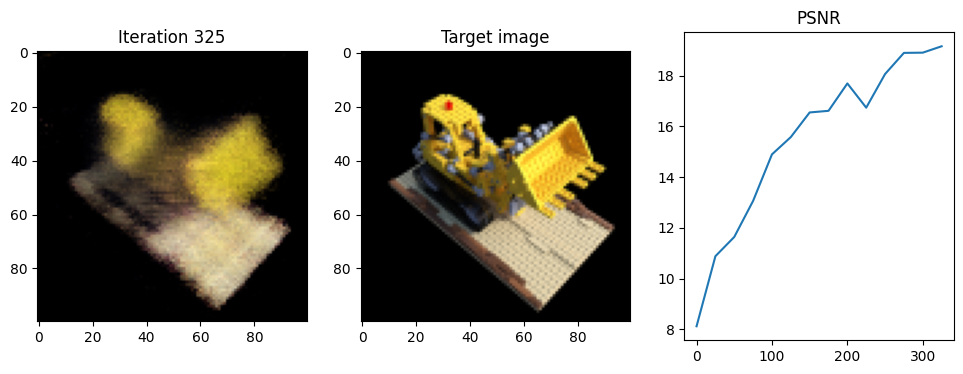

Iteration 350  Loss: 0.0132  PSNR: 18.81  Time: 0.91 secs per iter,  5.37 mins in total


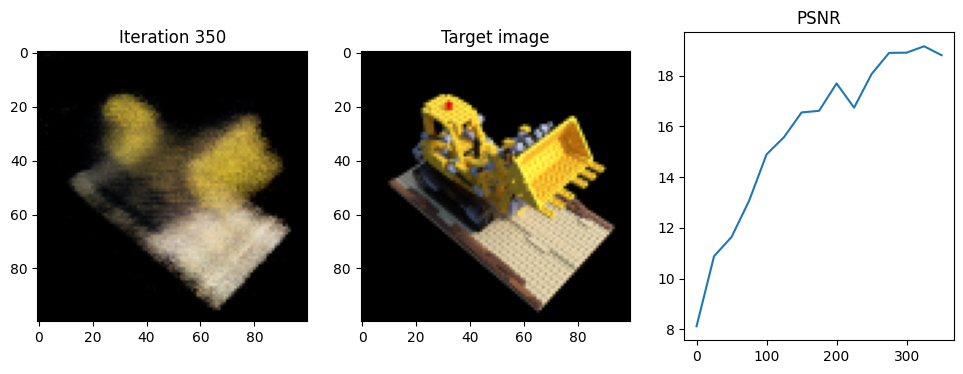

Iteration 375  Loss: 0.0114  PSNR: 19.42  Time: 0.91 secs per iter,  5.75 mins in total


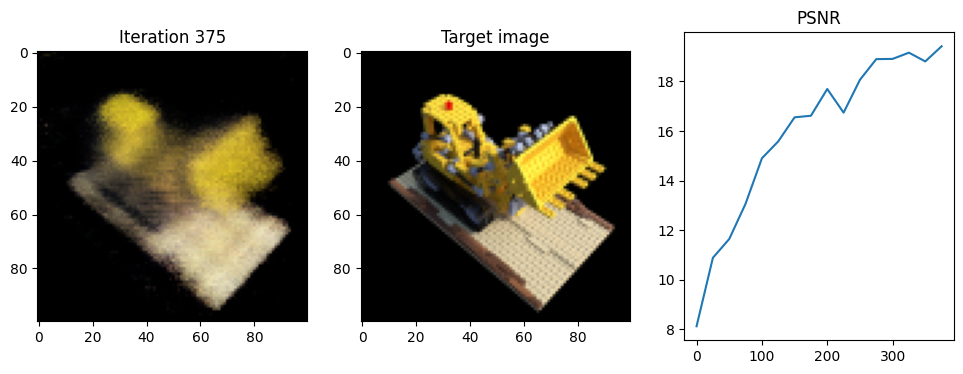

Iteration 400  Loss: 0.0101  PSNR: 19.95  Time: 0.90 secs per iter,  6.13 mins in total


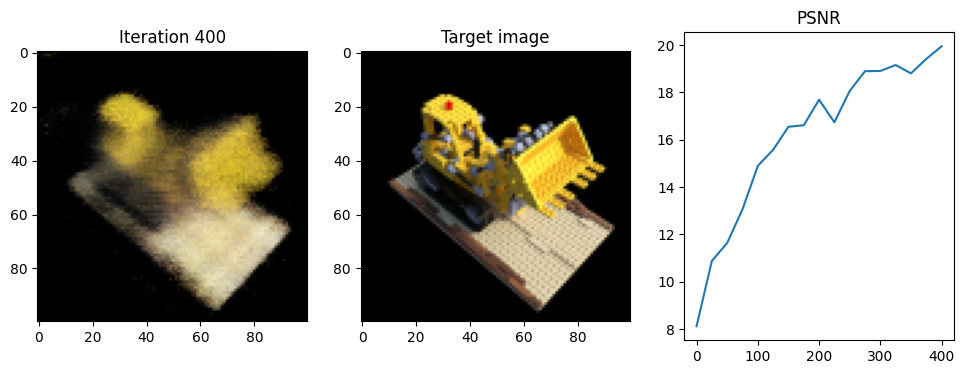

Iteration 425  Loss: 0.0121  PSNR: 19.18  Time: 0.90 secs per iter,  6.50 mins in total


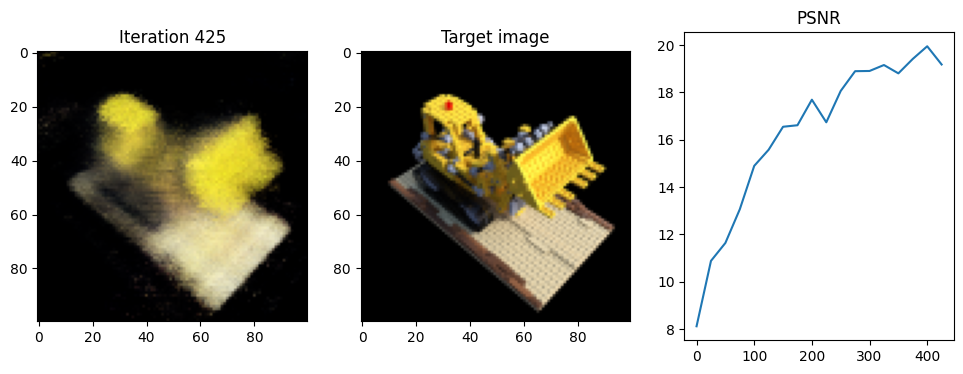

Iteration 450  Loss: 0.0099  PSNR: 20.03  Time: 0.91 secs per iter,  6.88 mins in total


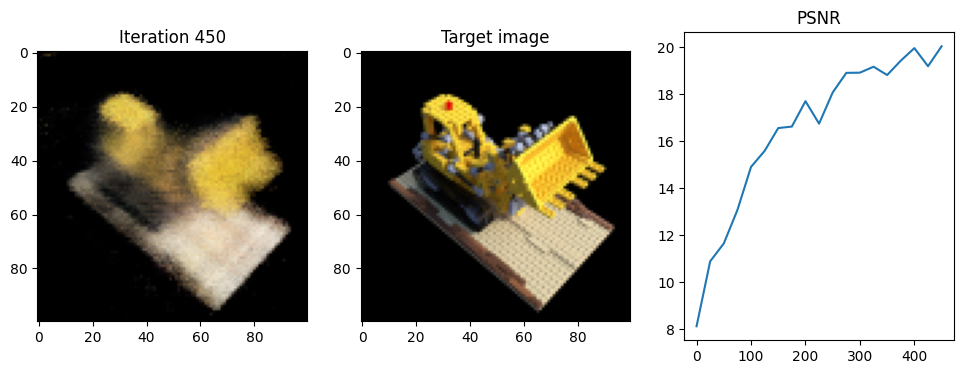

Iteration 475  Loss: 0.0095  PSNR: 20.23  Time: 0.91 secs per iter,  7.26 mins in total


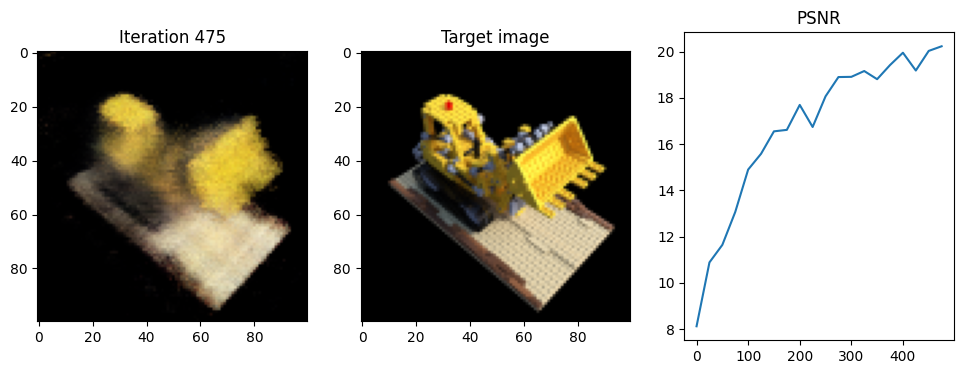

Iteration 500  Loss: 0.0099  PSNR: 20.07  Time: 0.90 secs per iter,  7.64 mins in total


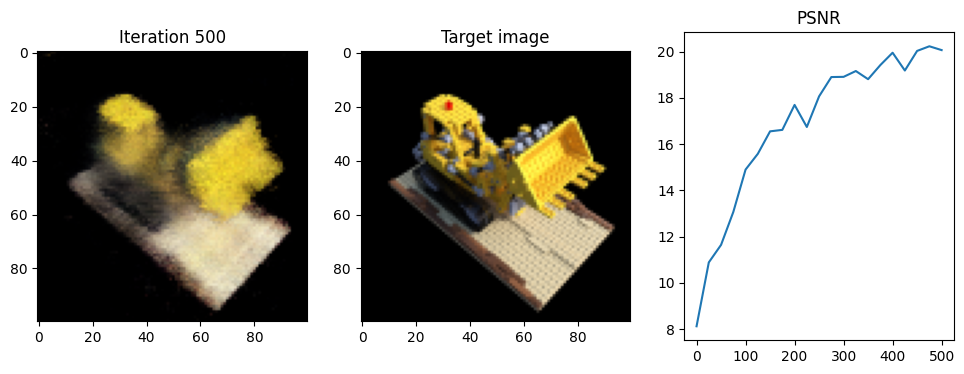

Iteration 525  Loss: 0.0106  PSNR: 19.76  Time: 0.90 secs per iter,  8.01 mins in total


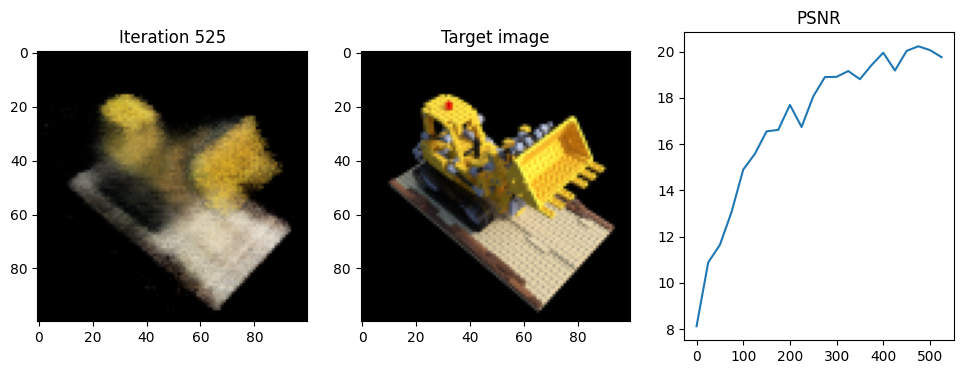

Iteration 550  Loss: 0.0092  PSNR: 20.36  Time: 0.90 secs per iter,  8.39 mins in total


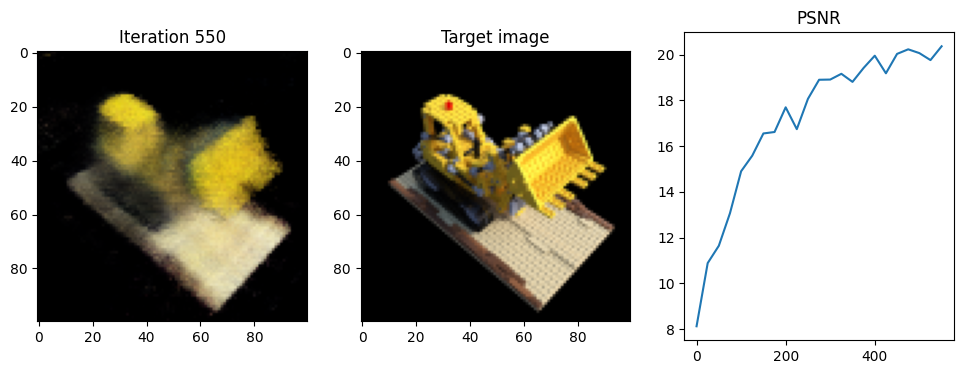

Iteration 575  Loss: 0.0083  PSNR: 20.82  Time: 0.90 secs per iter,  8.76 mins in total


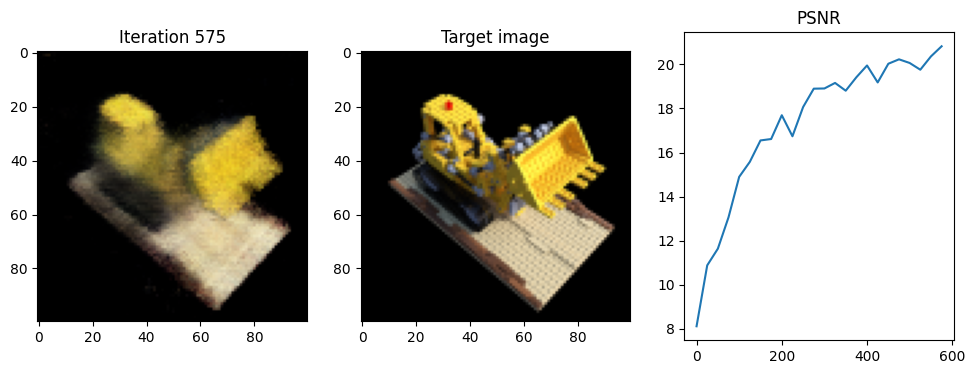

Iteration 600  Loss: 0.0085  PSNR: 20.73  Time: 0.90 secs per iter,  9.14 mins in total


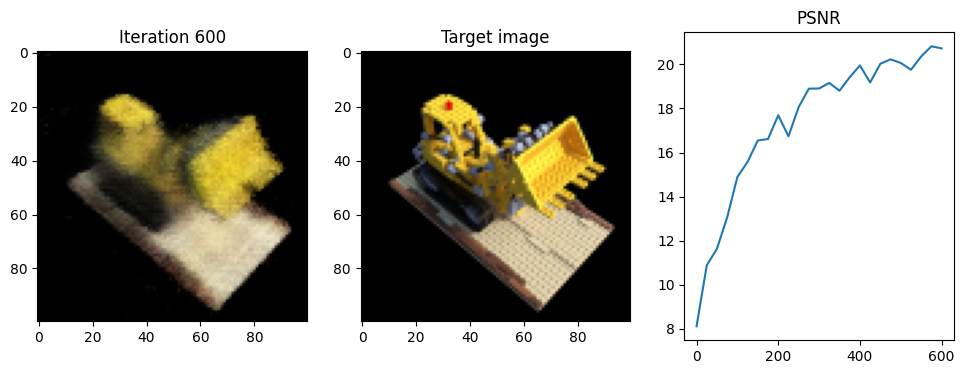

Iteration 625  Loss: 0.0081  PSNR: 20.90  Time: 0.90 secs per iter,  9.51 mins in total


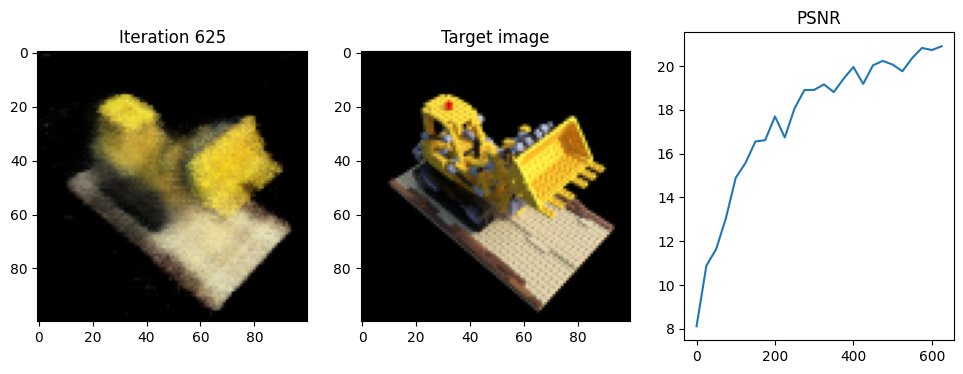

Iteration 650  Loss: 0.0103  PSNR: 19.87  Time: 0.90 secs per iter,  9.89 mins in total


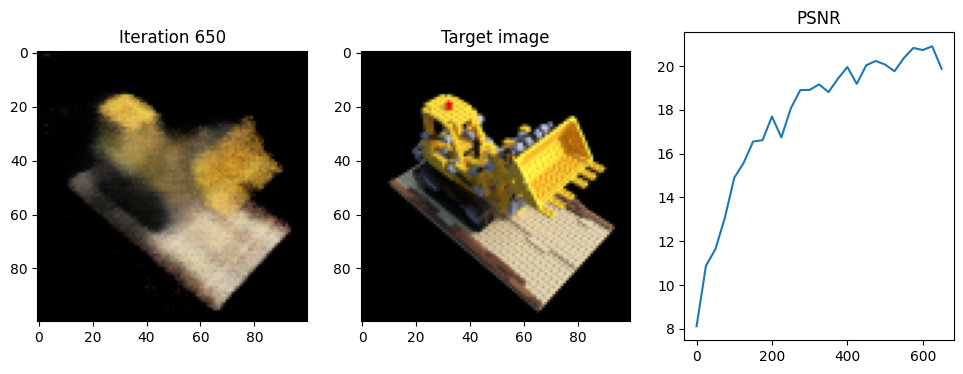

Iteration 675  Loss: 0.0093  PSNR: 20.33  Time: 0.91 secs per iter,  10.27 mins in total


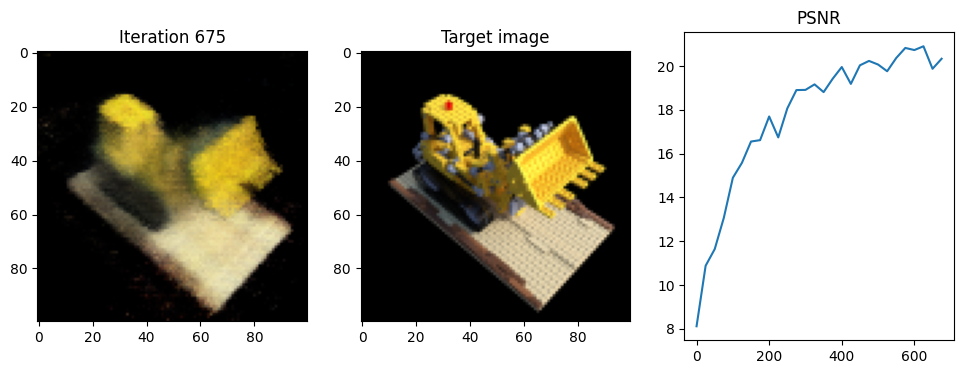

Iteration 700  Loss: 0.0087  PSNR: 20.62  Time: 0.90 secs per iter,  10.64 mins in total


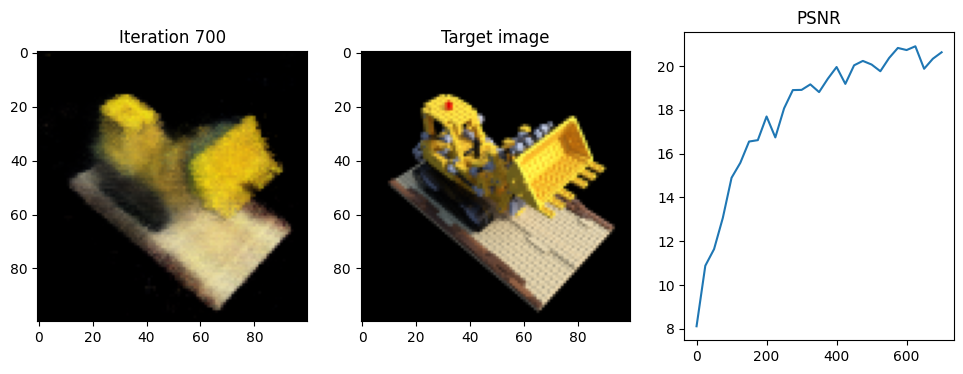

Iteration 725  Loss: 0.0075  PSNR: 21.27  Time: 0.90 secs per iter,  11.02 mins in total


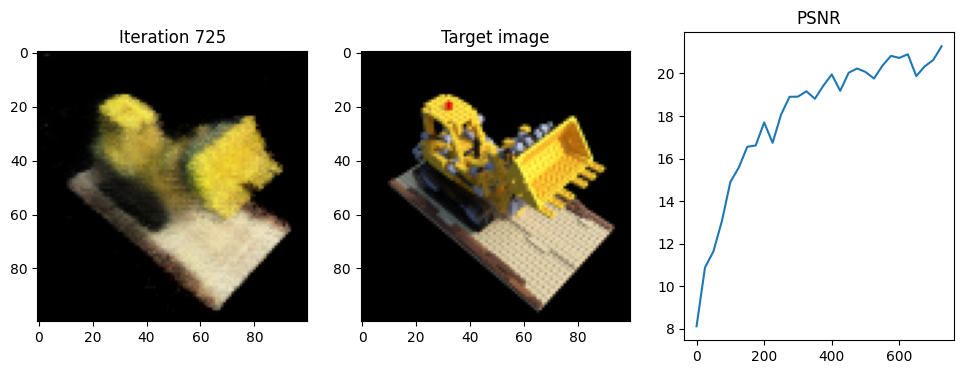

Iteration 750  Loss: 0.0077  PSNR: 21.14  Time: 0.90 secs per iter,  11.39 mins in total


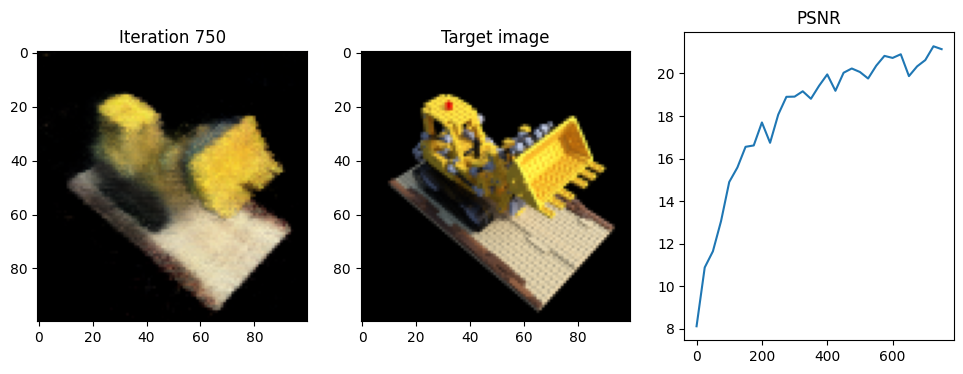

Iteration 775  Loss: 0.0075  PSNR: 21.24  Time: 0.90 secs per iter,  11.76 mins in total


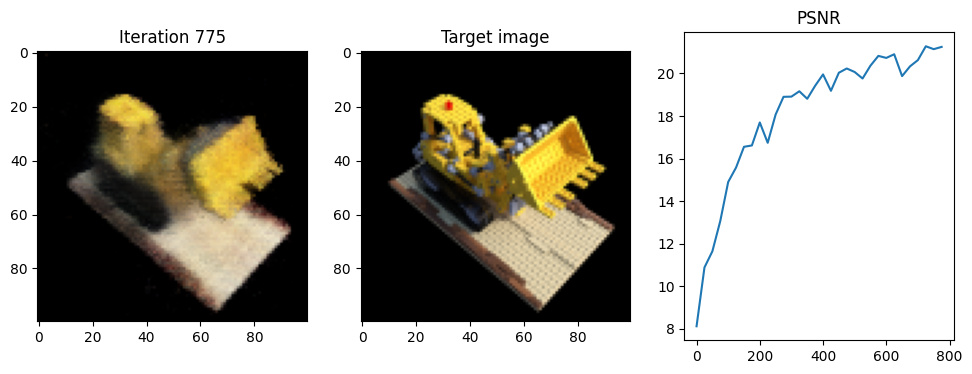

Iteration 800  Loss: 0.0082  PSNR: 20.87  Time: 0.89 secs per iter,  12.14 mins in total


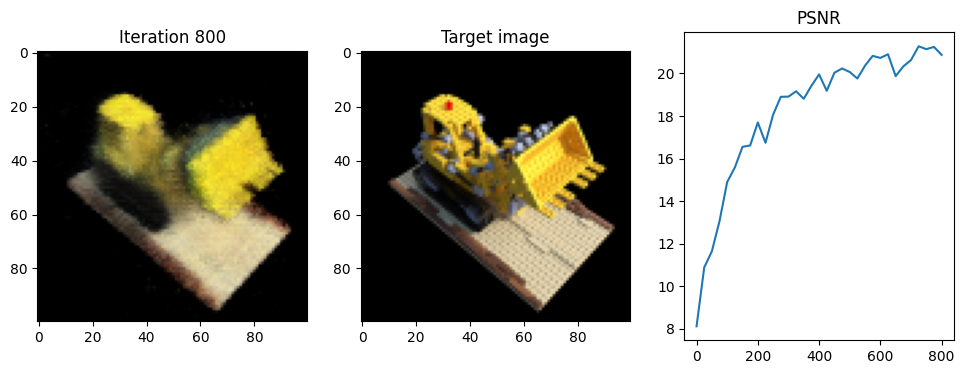

Iteration 825  Loss: 0.0084  PSNR: 20.78  Time: 0.90 secs per iter,  12.51 mins in total


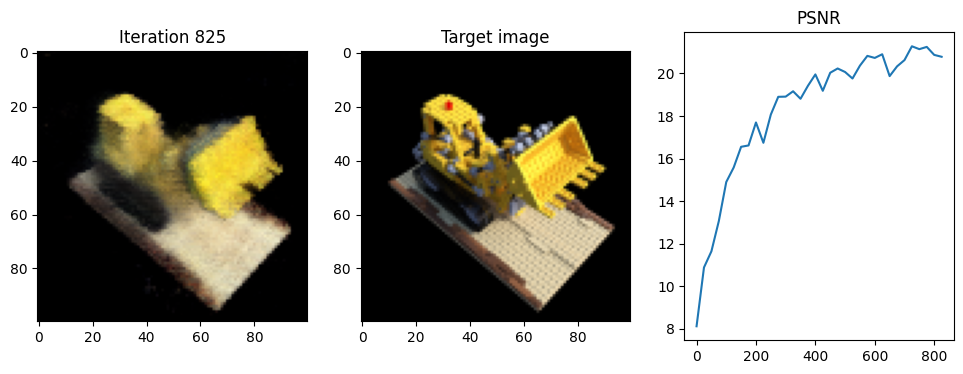

Iteration 850  Loss: 0.0083  PSNR: 20.82  Time: 0.90 secs per iter,  12.89 mins in total


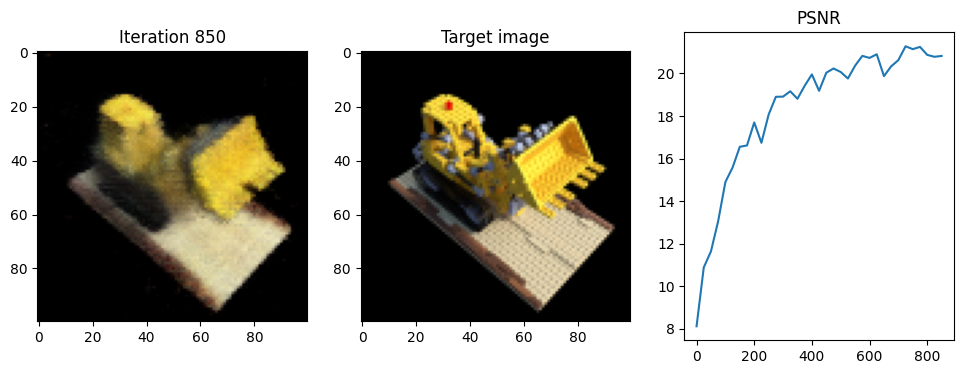

Iteration 875  Loss: 0.0069  PSNR: 21.63  Time: 0.89 secs per iter,  13.26 mins in total


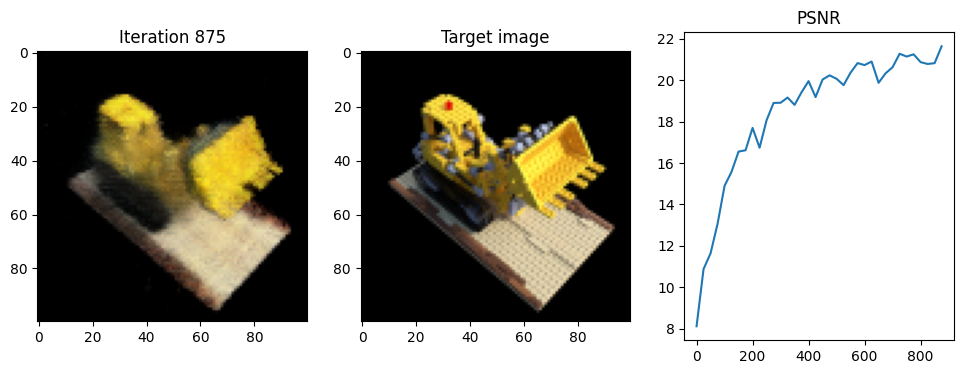

Iteration 900  Loss: 0.0075  PSNR: 21.26  Time: 0.89 secs per iter,  13.63 mins in total


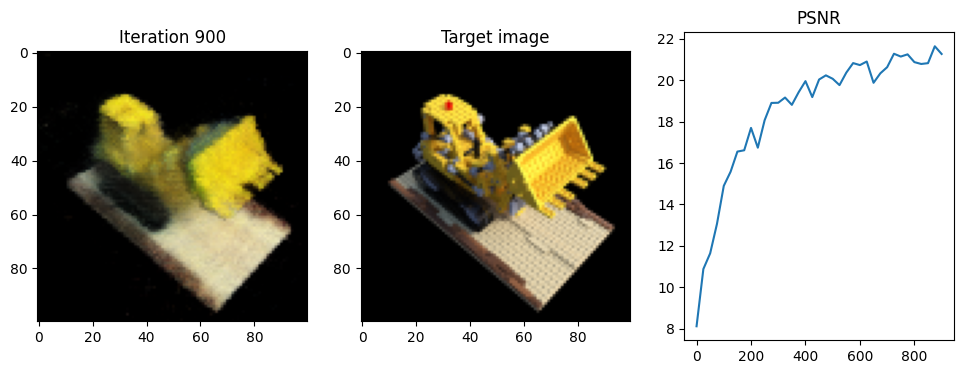

Iteration 925  Loss: 0.0072  PSNR: 21.40  Time: 0.90 secs per iter,  14.01 mins in total


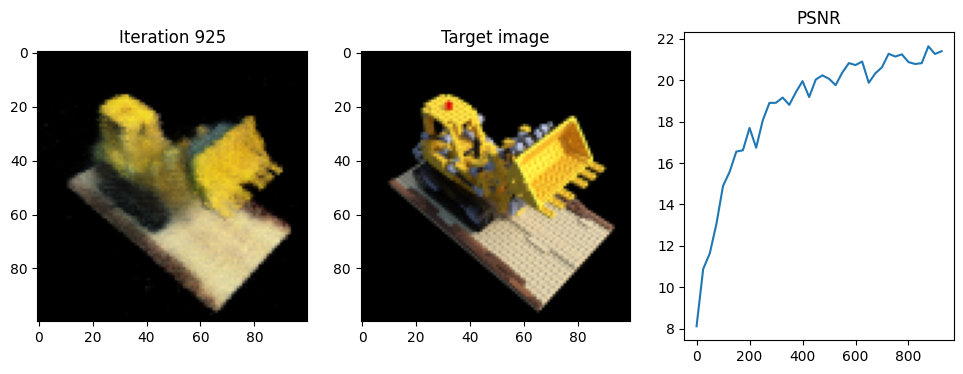

Iteration 950  Loss: 0.0065  PSNR: 21.86  Time: 0.90 secs per iter,  14.38 mins in total


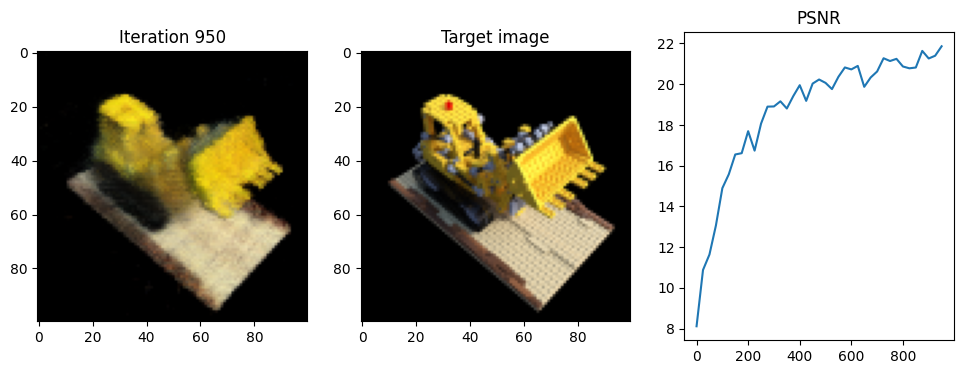

Iteration 975  Loss: 0.0064  PSNR: 21.95  Time: 0.89 secs per iter,  14.75 mins in total


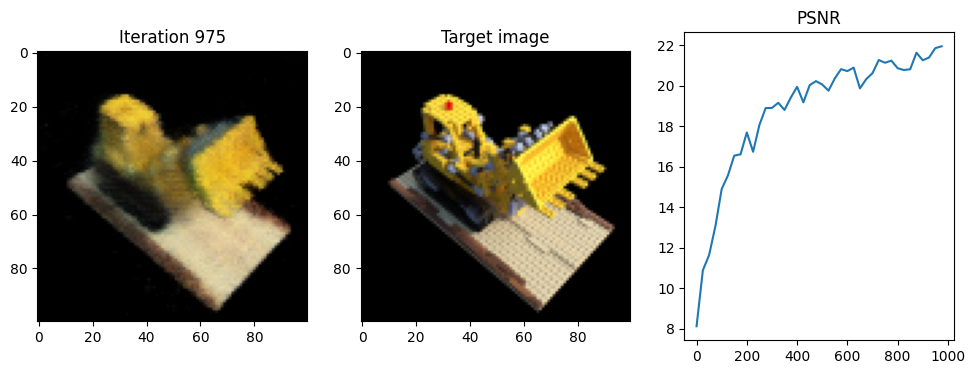

Iteration 1000  Loss: 0.0069  PSNR: 21.59  Time: 0.89 secs per iter,  15.13 mins in total


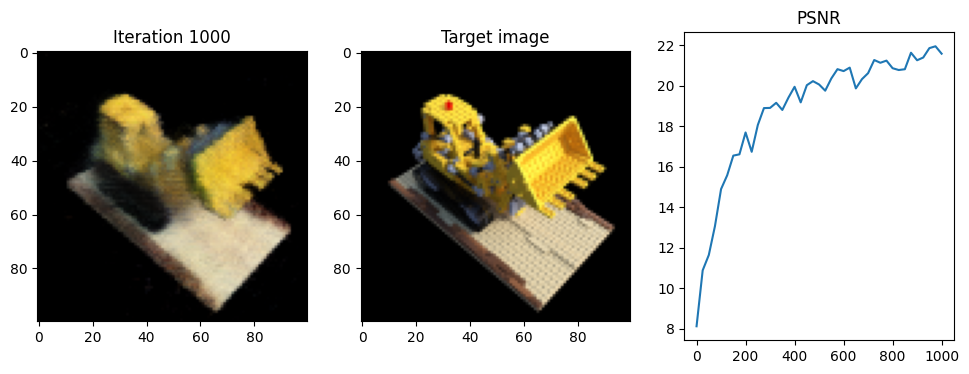

Iteration 1025  Loss: 0.0060  PSNR: 22.22  Time: 0.90 secs per iter,  15.50 mins in total


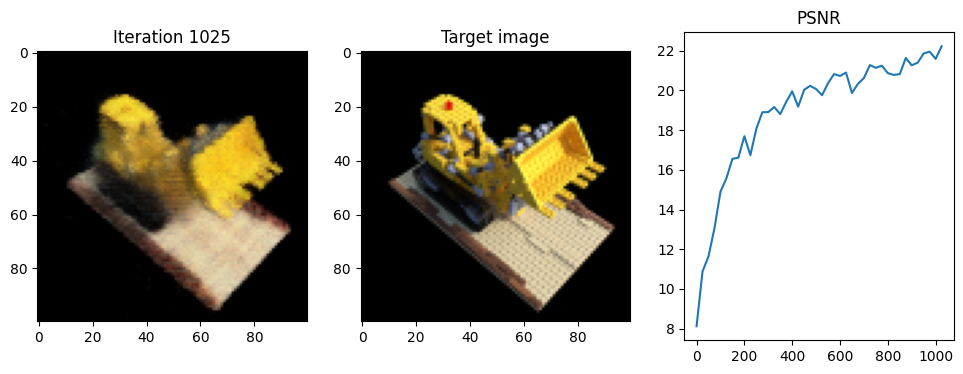

Iteration 1050  Loss: 0.0077  PSNR: 21.16  Time: 0.89 secs per iter,  15.87 mins in total


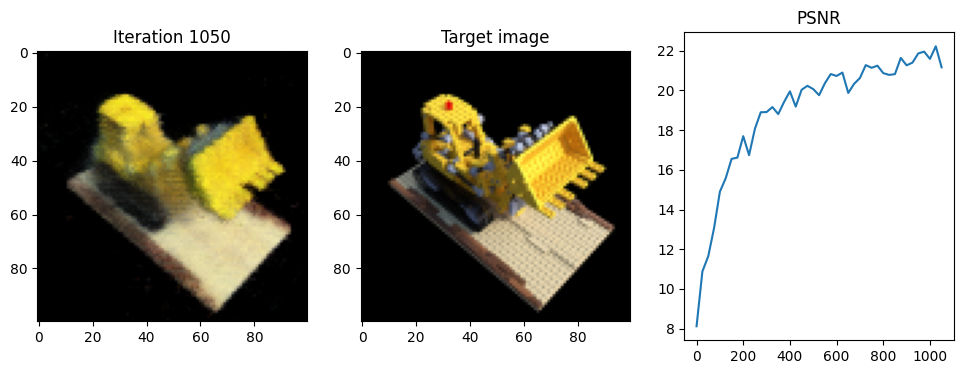

Iteration 1075  Loss: 0.0061  PSNR: 22.15  Time: 0.89 secs per iter,  16.25 mins in total


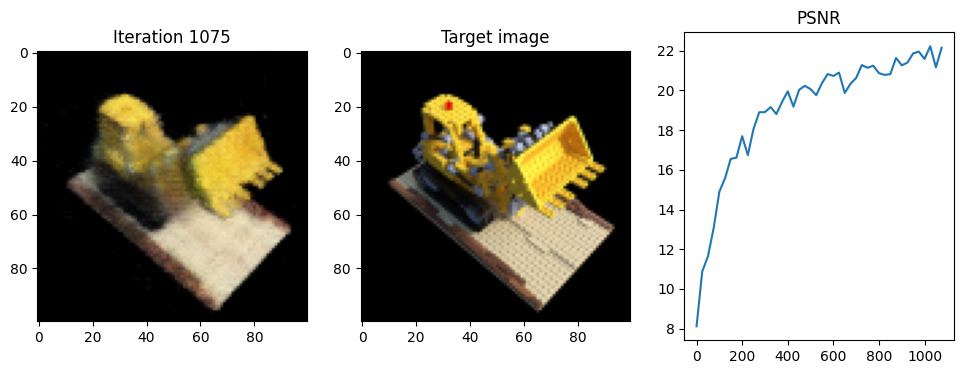

Iteration 1100  Loss: 0.0061  PSNR: 22.12  Time: 0.90 secs per iter,  16.62 mins in total


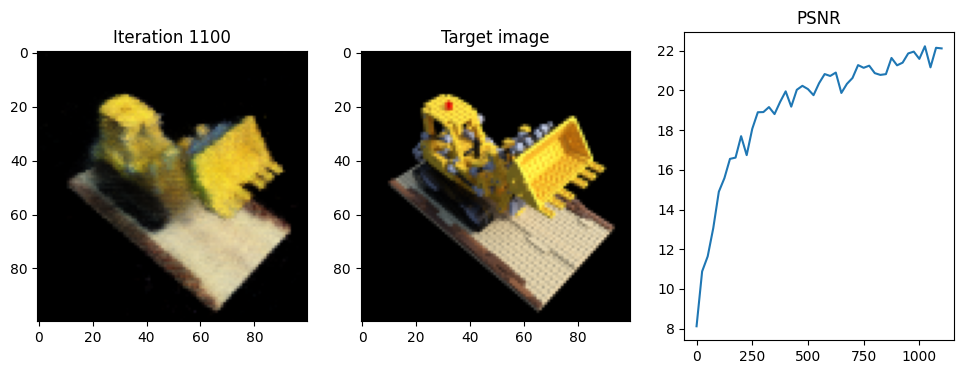

Iteration 1125  Loss: 0.0057  PSNR: 22.44  Time: 0.89 secs per iter,  16.99 mins in total


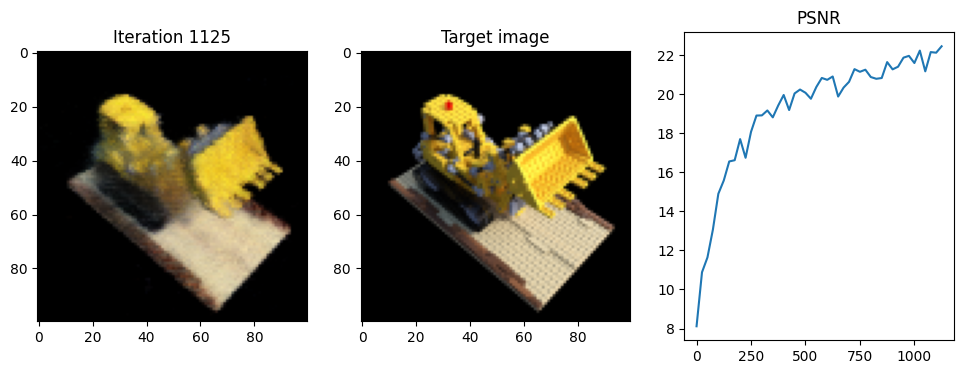

Iteration 1150  Loss: 0.0061  PSNR: 22.14  Time: 0.89 secs per iter,  17.37 mins in total


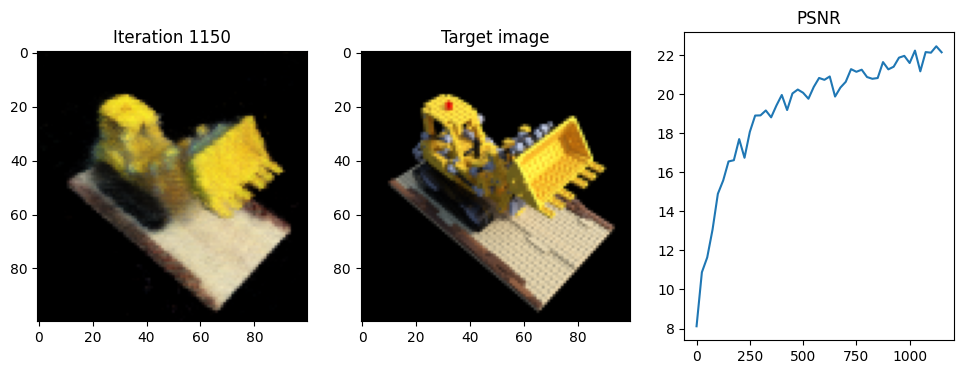

Iteration 1175  Loss: 0.0056  PSNR: 22.51  Time: 0.90 secs per iter,  17.74 mins in total


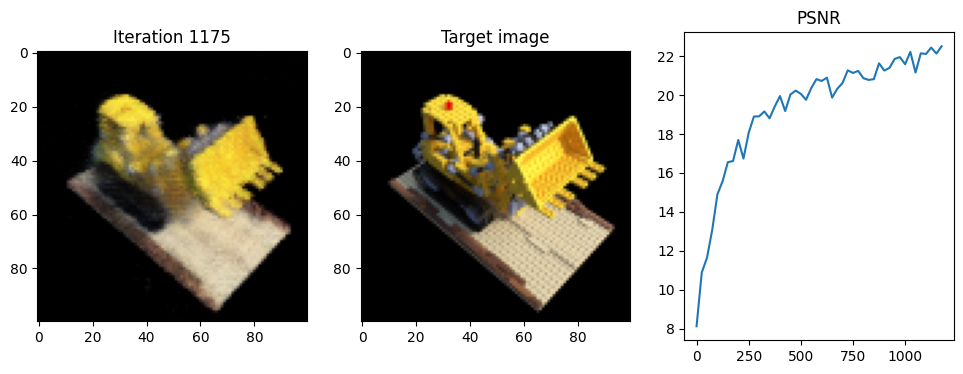

Iteration 1200  Loss: 0.0052  PSNR: 22.81  Time: 0.90 secs per iter,  18.12 mins in total


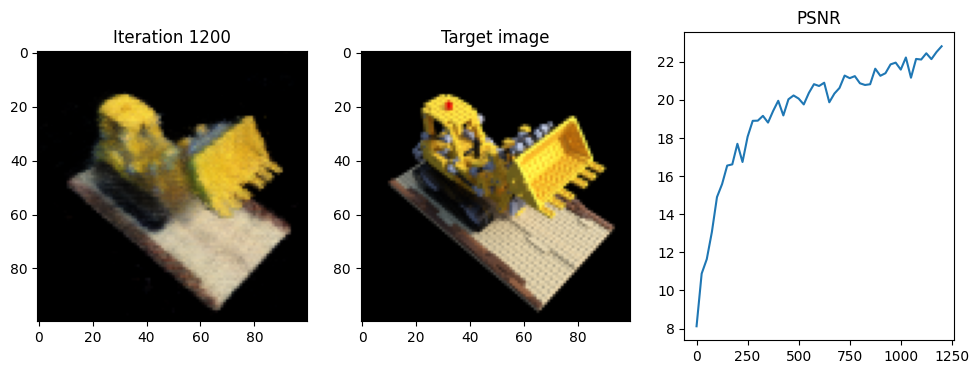

Iteration 1225  Loss: 0.0067  PSNR: 21.72  Time: 0.90 secs per iter,  18.49 mins in total


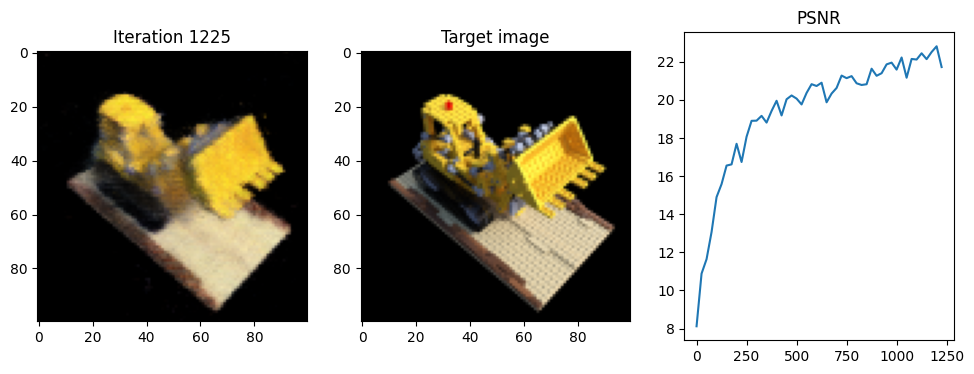

Iteration 1250  Loss: 0.0052  PSNR: 22.82  Time: 0.89 secs per iter,  18.86 mins in total


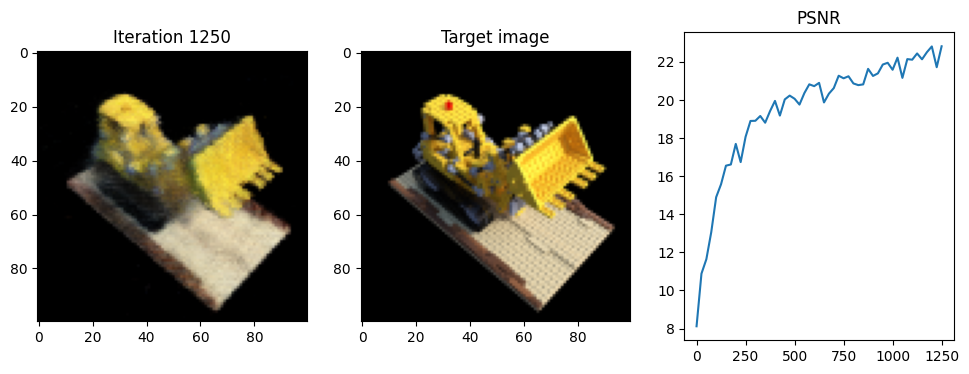

Iteration 1275  Loss: 0.0051  PSNR: 22.97  Time: 0.89 secs per iter,  19.23 mins in total


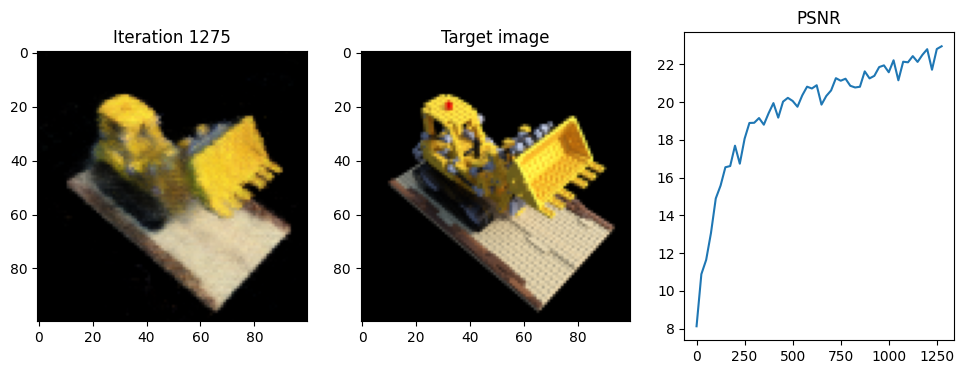

Iteration 1300  Loss: 0.0049  PSNR: 23.08  Time: 0.90 secs per iter,  19.61 mins in total


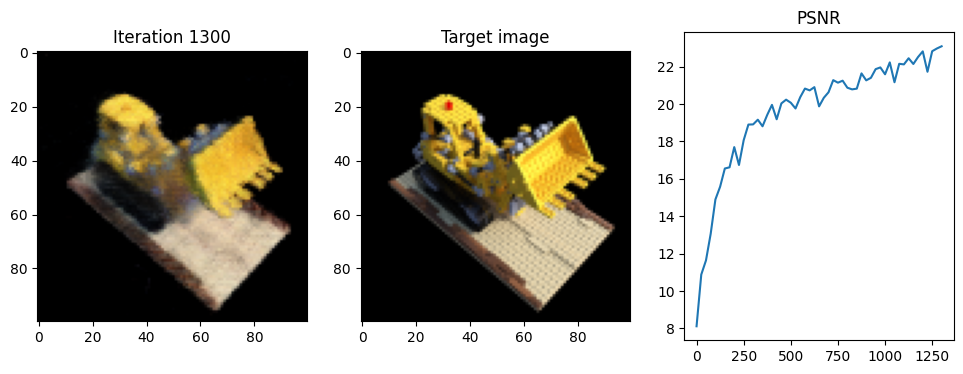

Iteration 1325  Loss: 0.0066  PSNR: 21.81  Time: 0.89 secs per iter,  19.98 mins in total


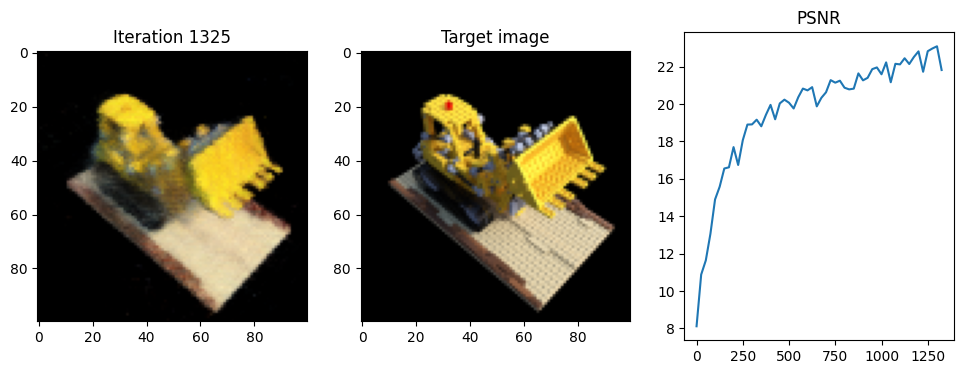

Iteration 1350  Loss: 0.0052  PSNR: 22.84  Time: 0.89 secs per iter,  20.35 mins in total


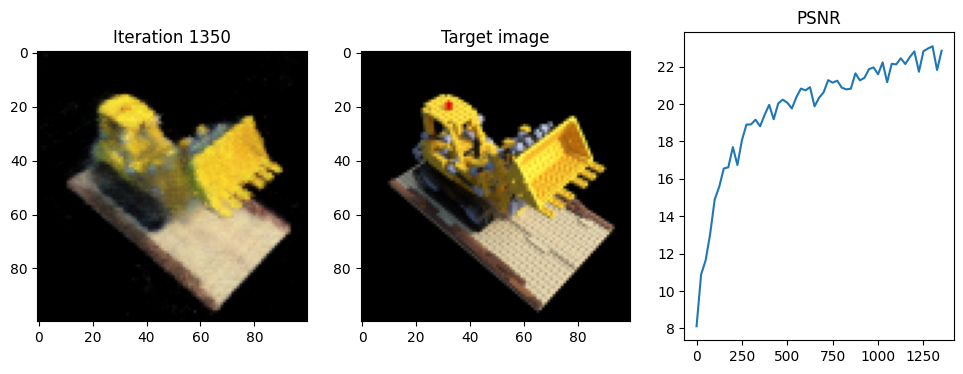

Iteration 1375  Loss: 0.0056  PSNR: 22.56  Time: 0.90 secs per iter,  20.73 mins in total


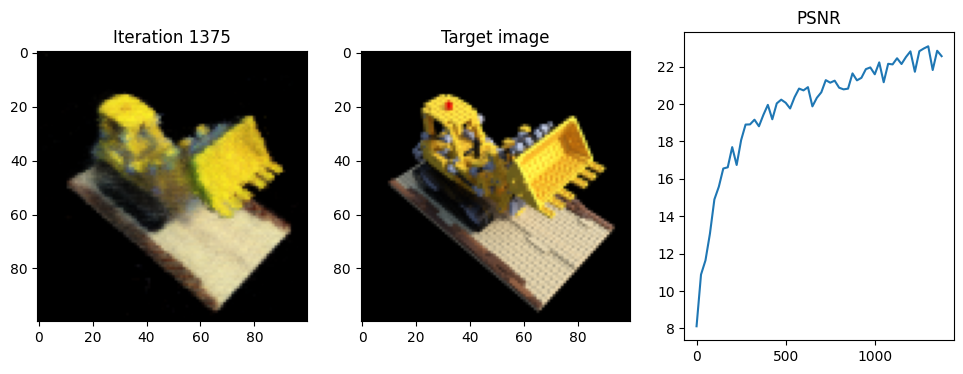

Iteration 1400  Loss: 0.0048  PSNR: 23.22  Time: 0.90 secs per iter,  21.10 mins in total


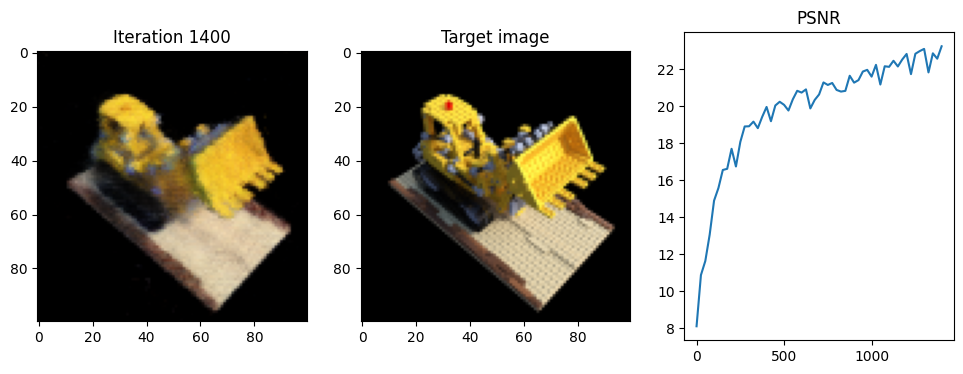

Iteration 1425  Loss: 0.0046  PSNR: 23.39  Time: 0.89 secs per iter,  21.48 mins in total


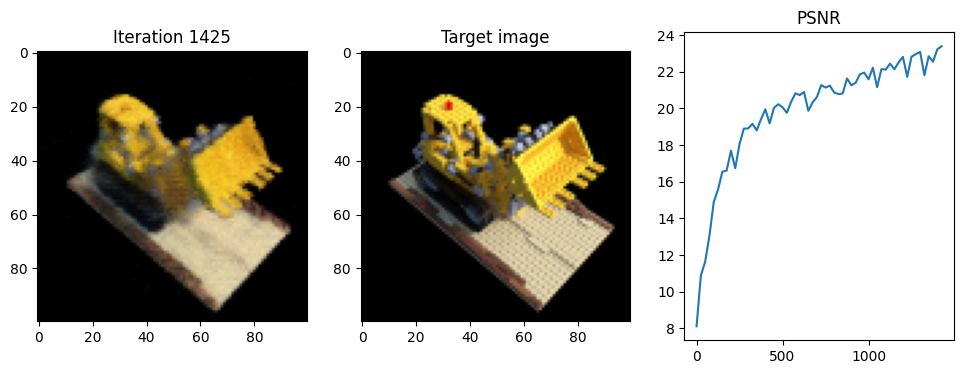

Iteration 1450  Loss: 0.0056  PSNR: 22.51  Time: 0.89 secs per iter,  21.85 mins in total


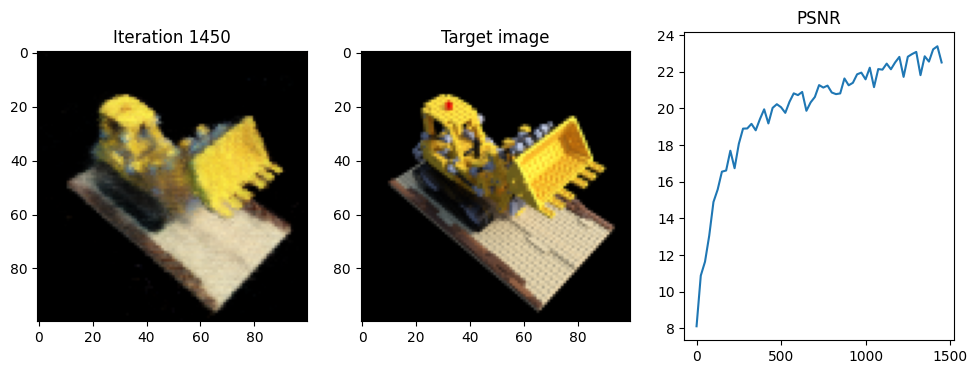

Iteration 1475  Loss: 0.0047  PSNR: 23.32  Time: 0.90 secs per iter,  22.22 mins in total


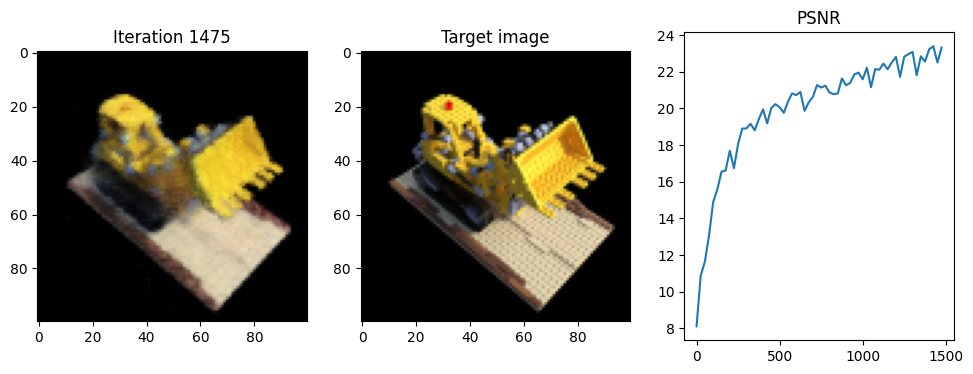

Iteration 1500  Loss: 0.0046  PSNR: 23.41  Time: 0.89 secs per iter,  22.59 mins in total


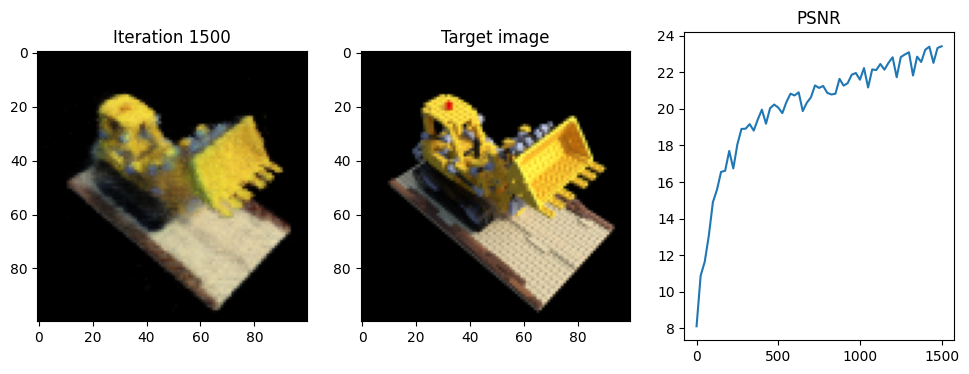

Iteration 1525  Loss: 0.0058  PSNR: 22.40  Time: 0.89 secs per iter,  22.97 mins in total


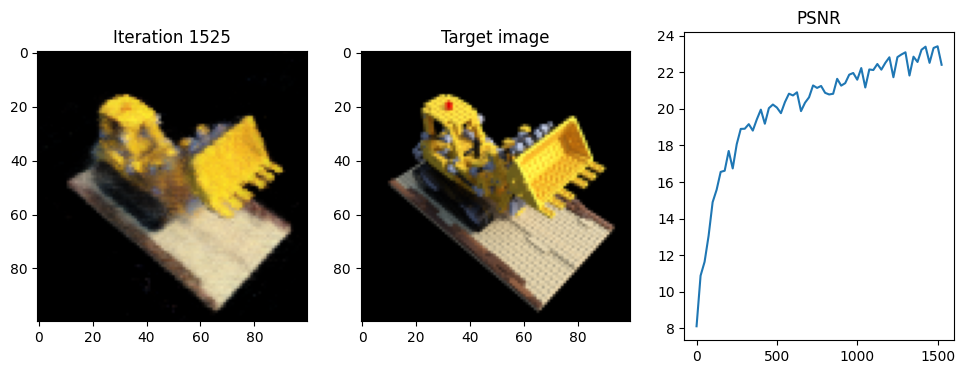

Iteration 1550  Loss: 0.0050  PSNR: 22.99  Time: 0.90 secs per iter,  23.34 mins in total


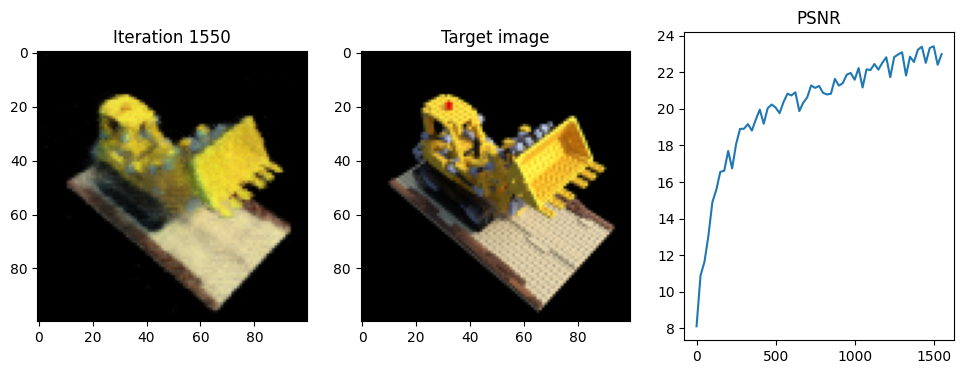

Iteration 1575  Loss: 0.0055  PSNR: 22.56  Time: 0.90 secs per iter,  23.72 mins in total


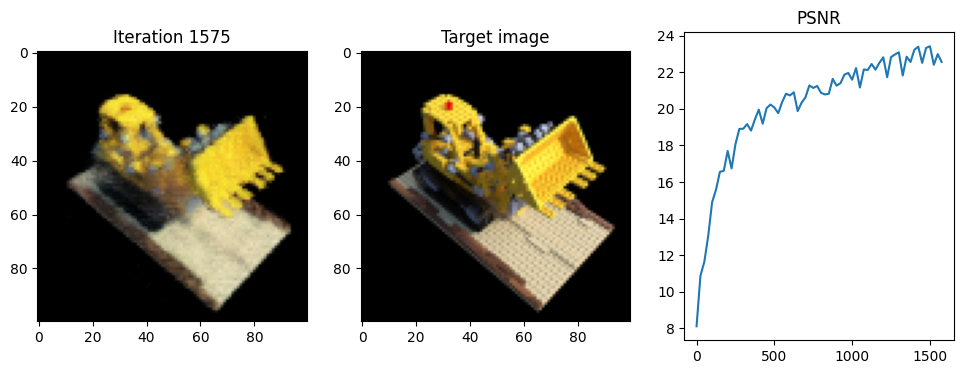

Iteration 1600  Loss: 0.0053  PSNR: 22.79  Time: 0.90 secs per iter,  24.09 mins in total


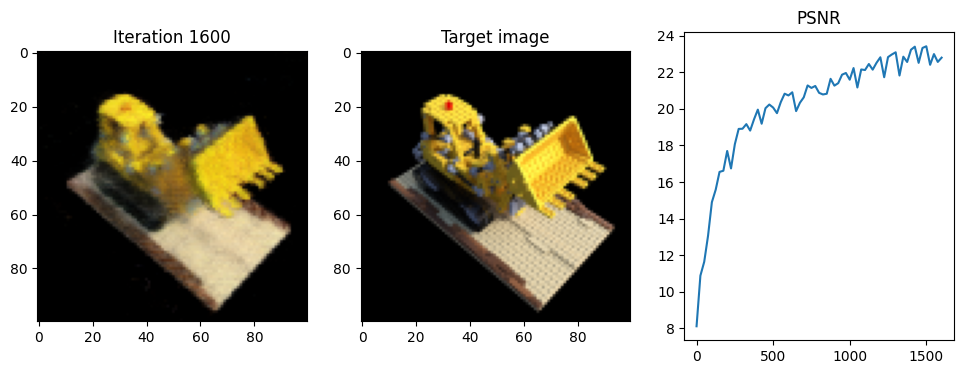

Iteration 1625  Loss: 0.0048  PSNR: 23.21  Time: 0.89 secs per iter,  24.46 mins in total


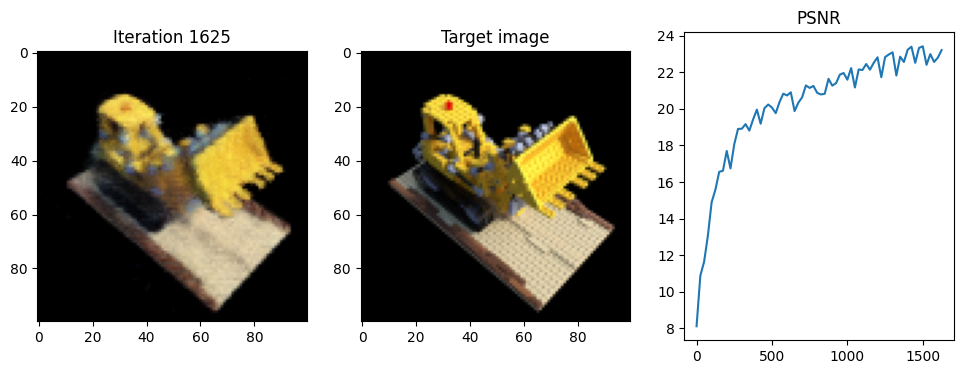

Iteration 1650  Loss: 0.0049  PSNR: 23.12  Time: 0.89 secs per iter,  24.84 mins in total


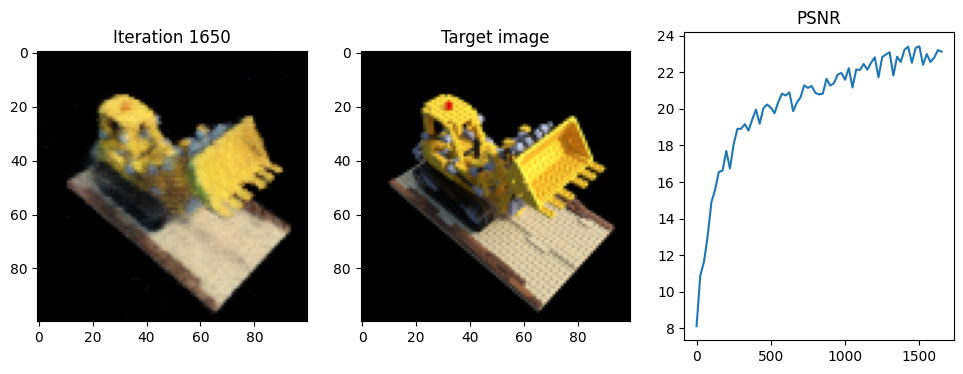

Iteration 1675  Loss: 0.0050  PSNR: 22.97  Time: 0.89 secs per iter,  25.21 mins in total


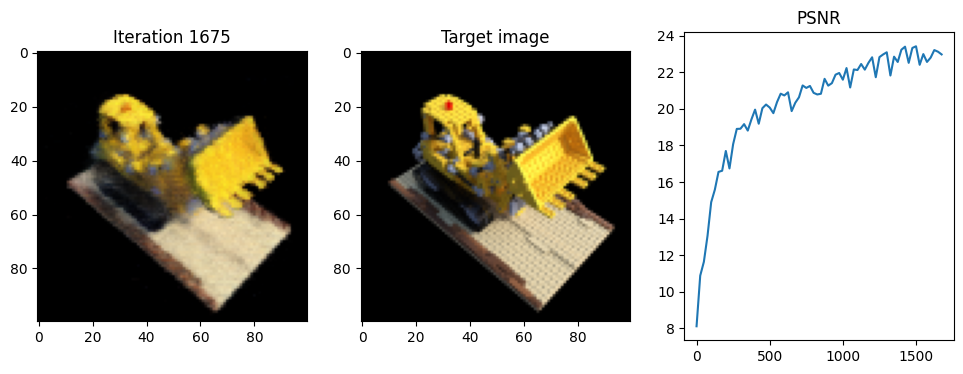

Iteration 1700  Loss: 0.0047  PSNR: 23.31  Time: 0.89 secs per iter,  25.58 mins in total


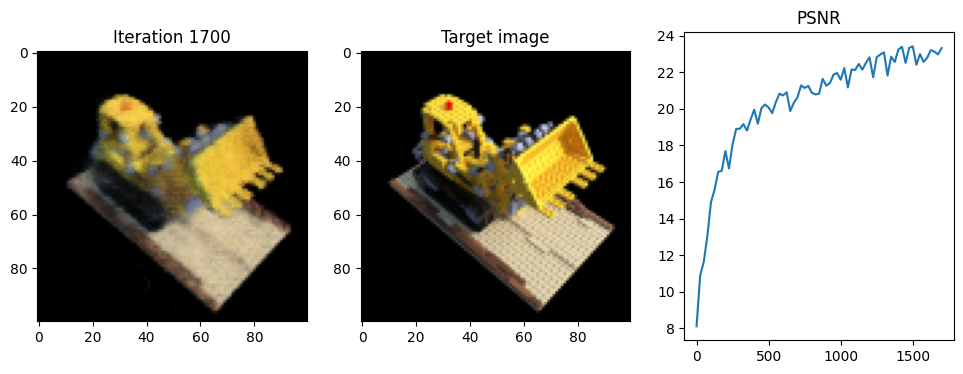

Iteration 1725  Loss: 0.0046  PSNR: 23.37  Time: 0.90 secs per iter,  25.96 mins in total


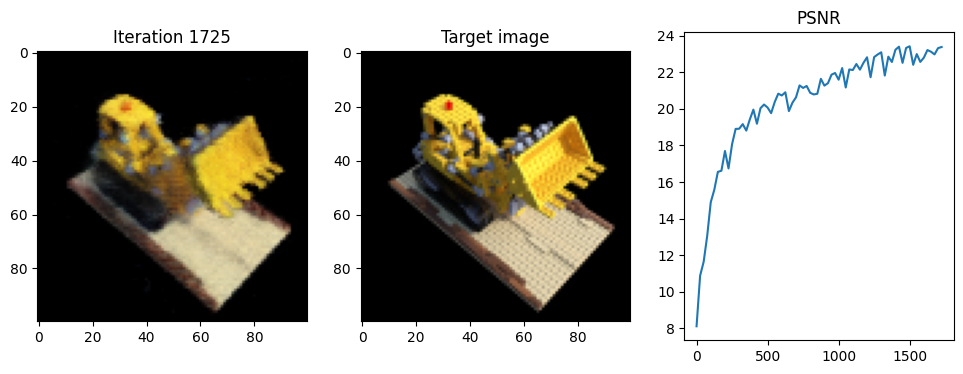

Iteration 1750  Loss: 0.0043  PSNR: 23.64  Time: 0.90 secs per iter,  26.33 mins in total


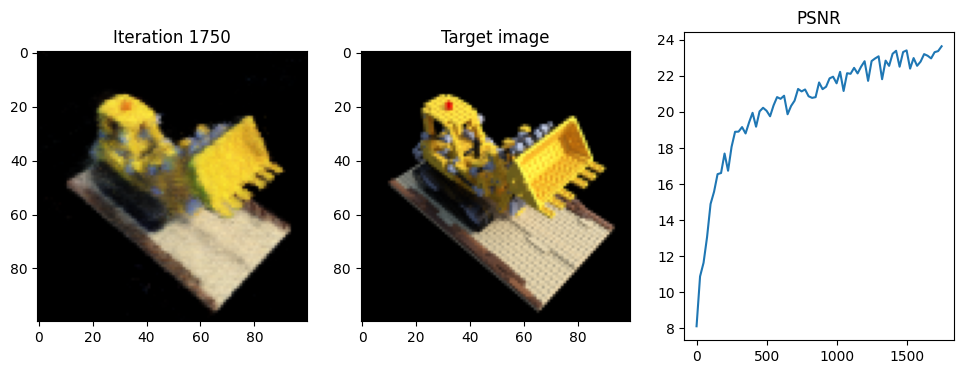

Iteration 1775  Loss: 0.0047  PSNR: 23.24  Time: 0.89 secs per iter,  26.70 mins in total


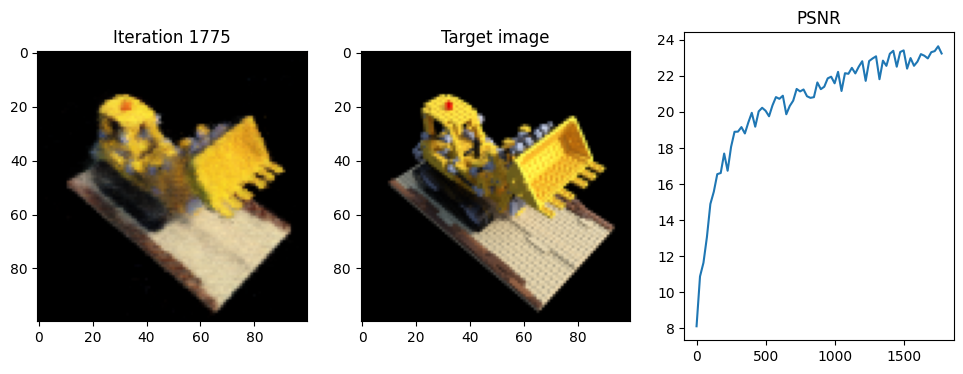

Iteration 1800  Loss: 0.0054  PSNR: 22.72  Time: 0.89 secs per iter,  27.08 mins in total


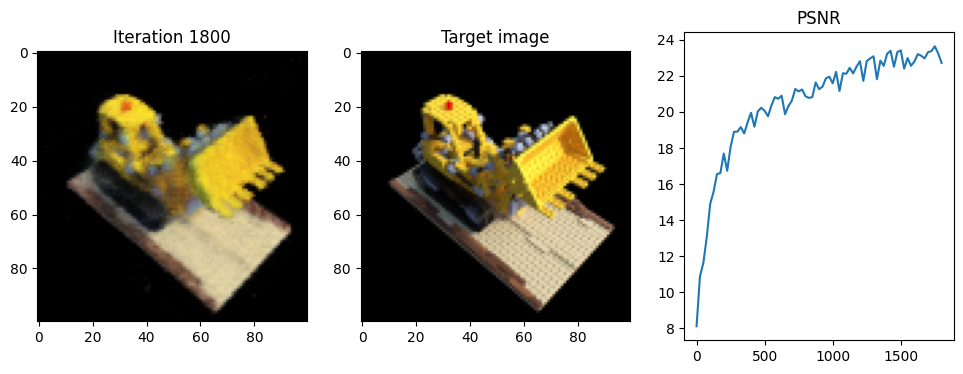

Iteration 1825  Loss: 0.0043  PSNR: 23.62  Time: 0.89 secs per iter,  27.45 mins in total


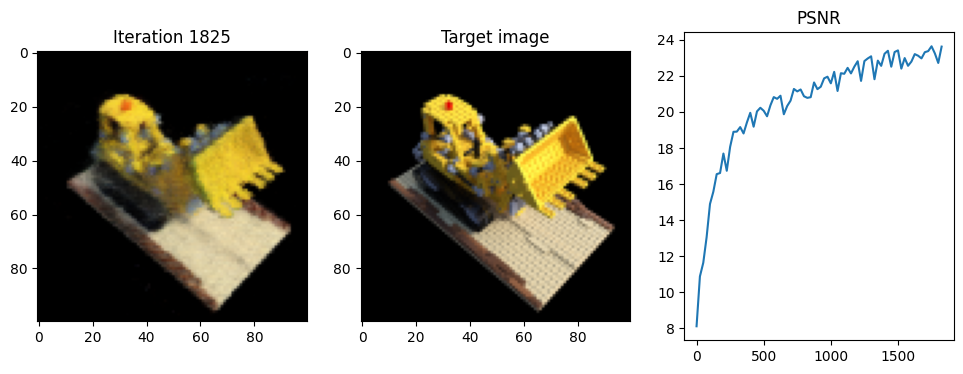

Iteration 1850  Loss: 0.0042  PSNR: 23.72  Time: 0.90 secs per iter,  27.82 mins in total


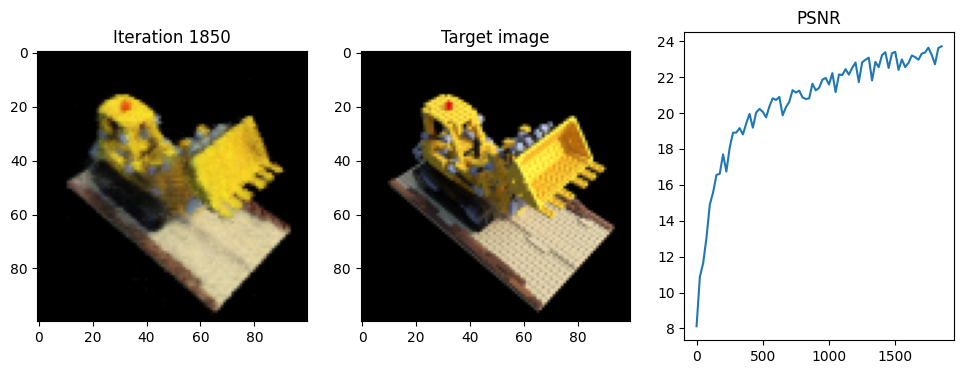

Iteration 1875  Loss: 0.0047  PSNR: 23.31  Time: 0.89 secs per iter,  28.19 mins in total


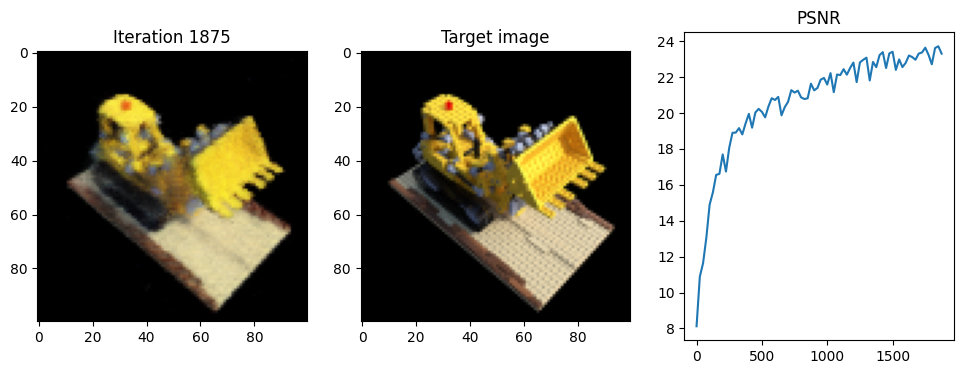

Iteration 1900  Loss: 0.0038  PSNR: 24.20  Time: 0.90 secs per iter,  28.57 mins in total


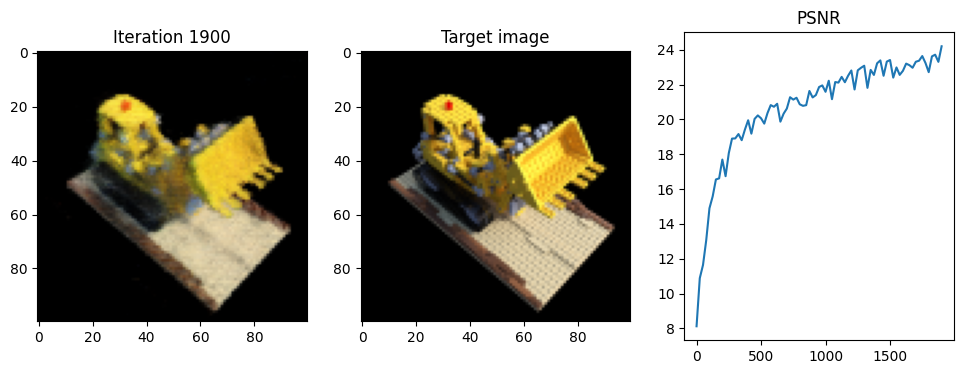

Iteration 1925  Loss: 0.0047  PSNR: 23.30  Time: 0.90 secs per iter,  28.95 mins in total


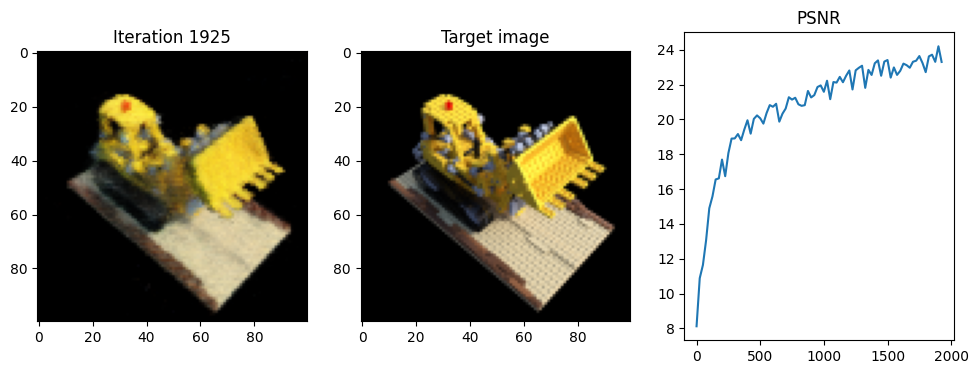

Iteration 1950  Loss: 0.0041  PSNR: 23.91  Time: 0.89 secs per iter,  29.32 mins in total


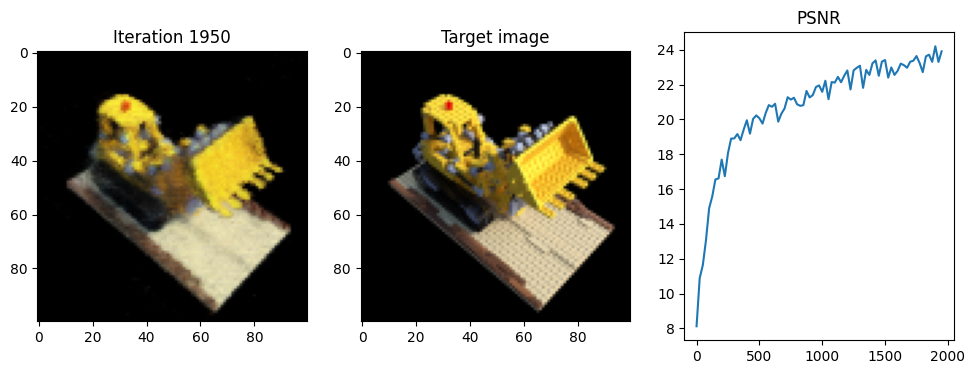

Iteration 1975  Loss: 0.0047  PSNR: 23.28  Time: 0.90 secs per iter,  29.69 mins in total


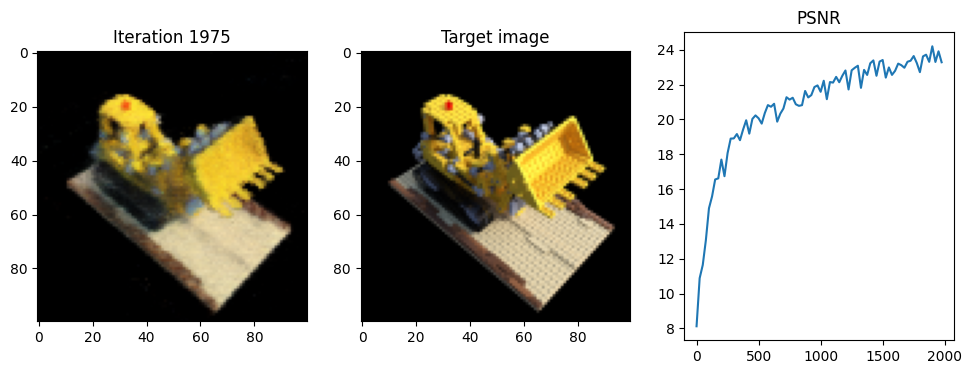

Iteration 2000  Loss: 0.0047  PSNR: 23.30  Time: 0.89 secs per iter,  30.06 mins in total


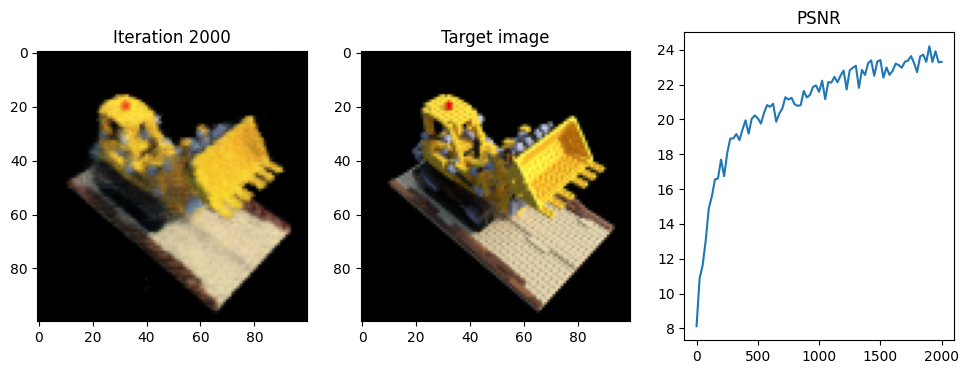

Iteration 2025  Loss: 0.0038  PSNR: 24.24  Time: 0.89 secs per iter,  30.44 mins in total


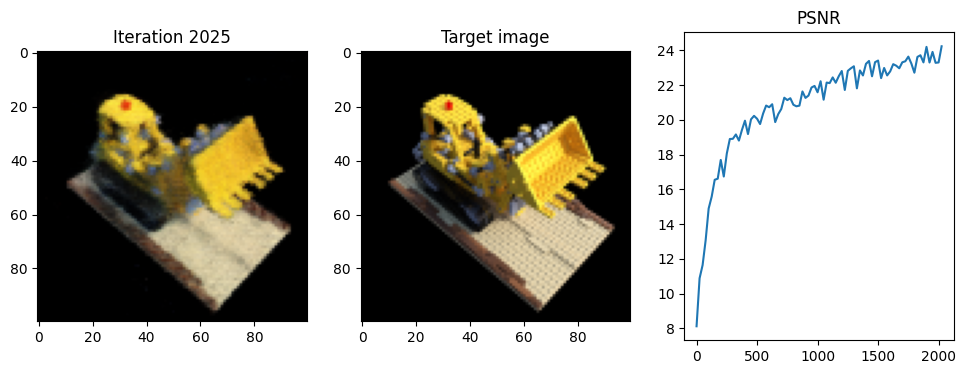

Iteration 2050  Loss: 0.0042  PSNR: 23.73  Time: 0.90 secs per iter,  30.81 mins in total


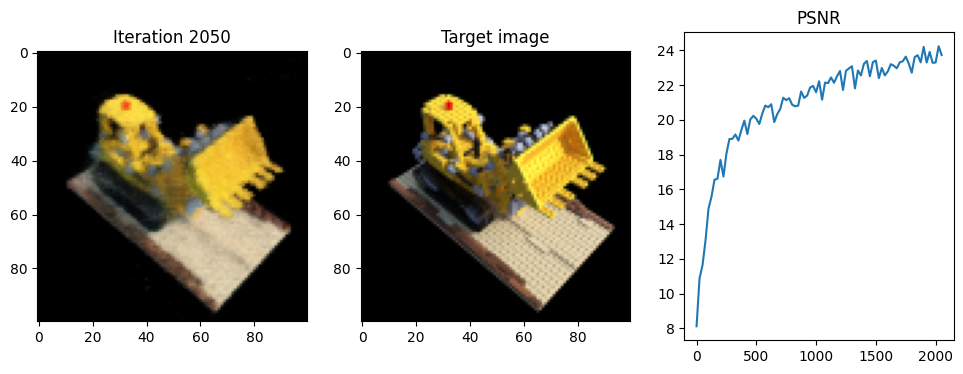

Iteration 2075  Loss: 0.0047  PSNR: 23.25  Time: 0.90 secs per iter,  31.19 mins in total


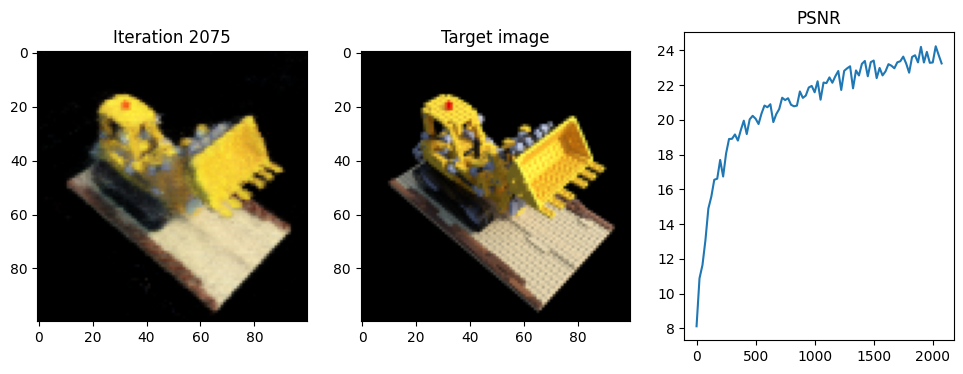

Iteration 2100  Loss: 0.0043  PSNR: 23.65  Time: 0.90 secs per iter,  31.56 mins in total


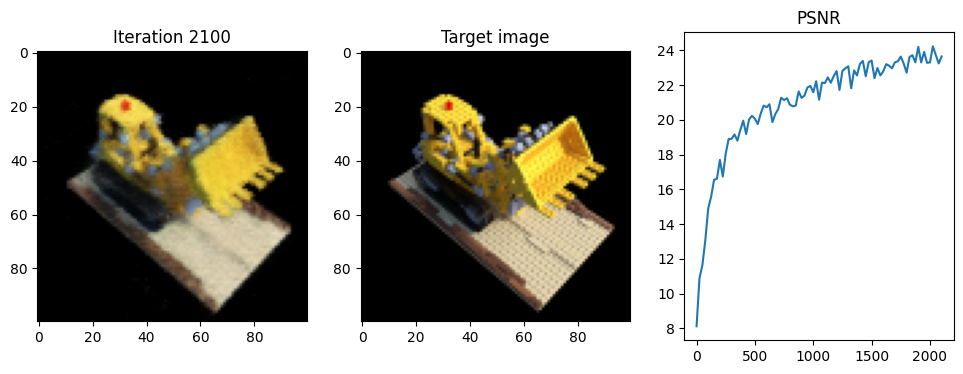

Iteration 2125  Loss: 0.0039  PSNR: 24.12  Time: 0.89 secs per iter,  31.93 mins in total


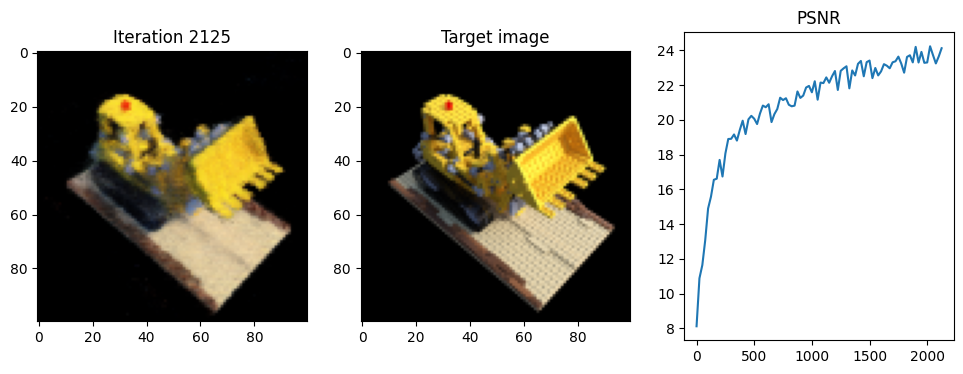

Iteration 2150  Loss: 0.0038  PSNR: 24.20  Time: 0.89 secs per iter,  32.31 mins in total


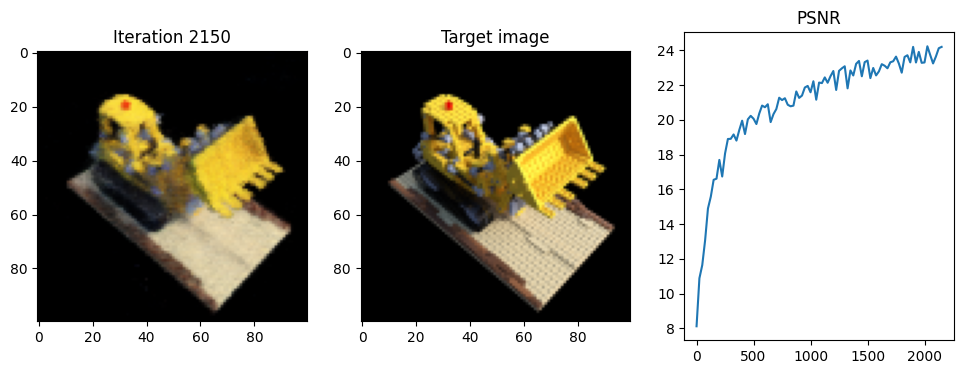

Iteration 2175  Loss: 0.0042  PSNR: 23.72  Time: 0.89 secs per iter,  32.68 mins in total


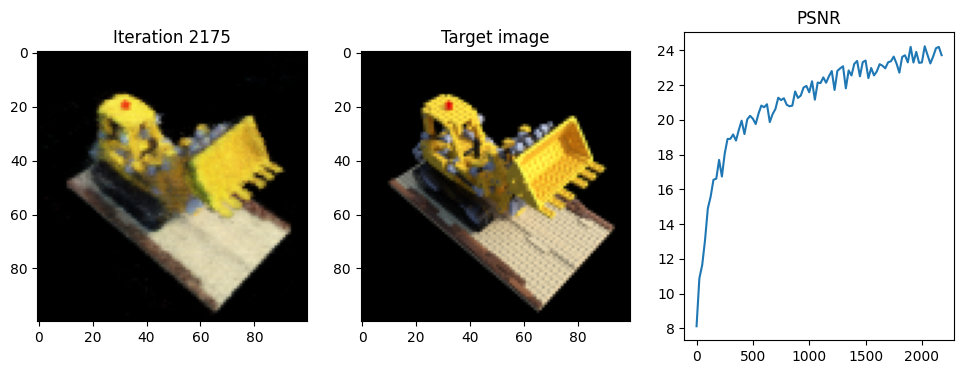

Iteration 2200  Loss: 0.0043  PSNR: 23.69  Time: 0.89 secs per iter,  33.05 mins in total


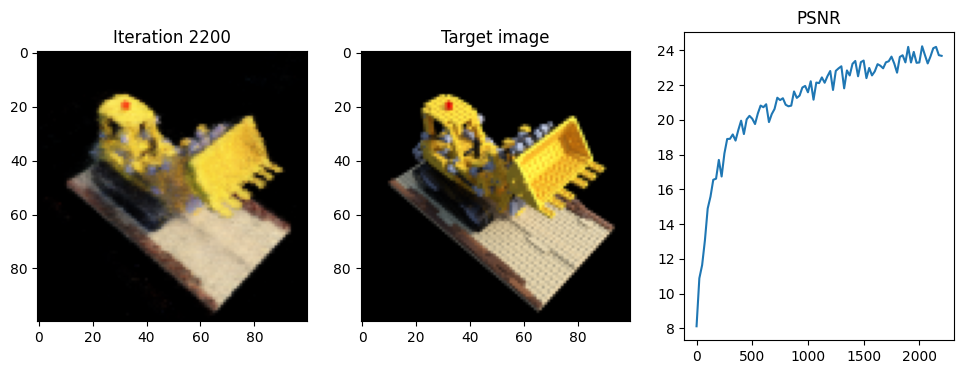

Iteration 2225  Loss: 0.0041  PSNR: 23.85  Time: 0.89 secs per iter,  33.42 mins in total


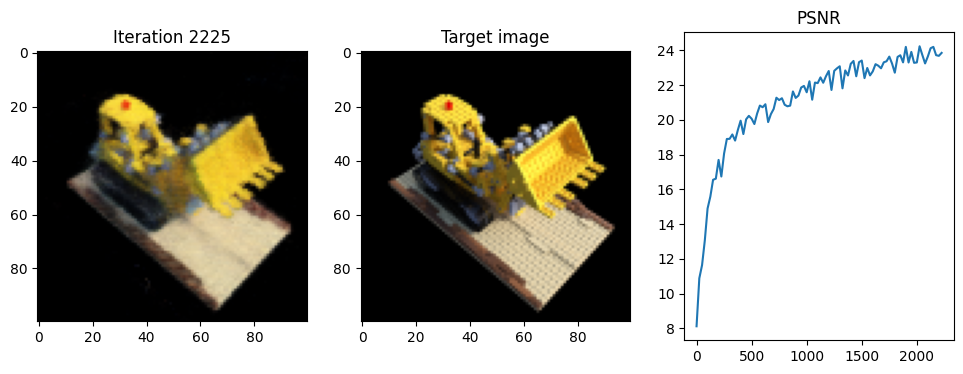

Iteration 2250  Loss: 0.0036  PSNR: 24.38  Time: 0.89 secs per iter,  33.80 mins in total


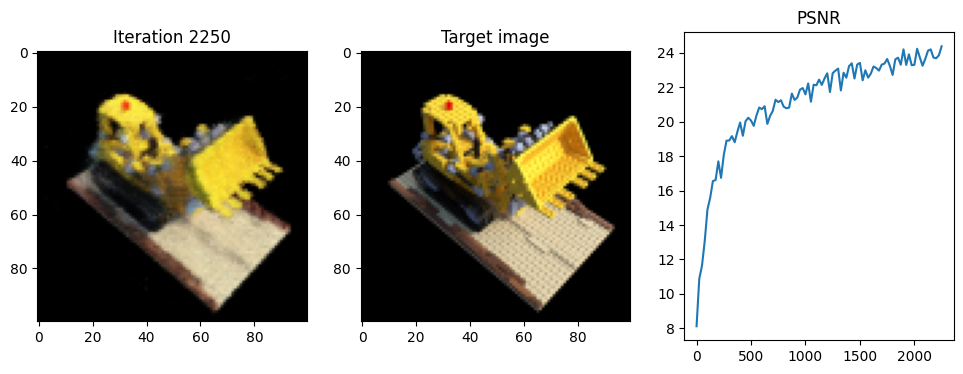

Iteration 2275  Loss: 0.0042  PSNR: 23.76  Time: 0.90 secs per iter,  34.17 mins in total


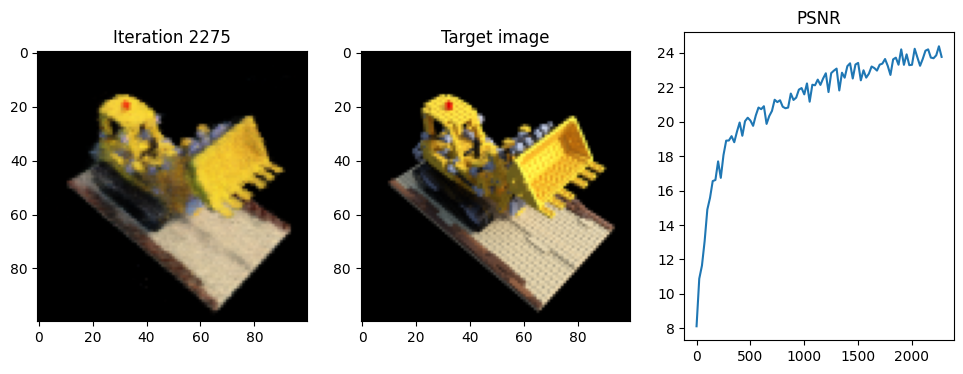

Iteration 2300  Loss: 0.0039  PSNR: 24.12  Time: 0.89 secs per iter,  34.54 mins in total


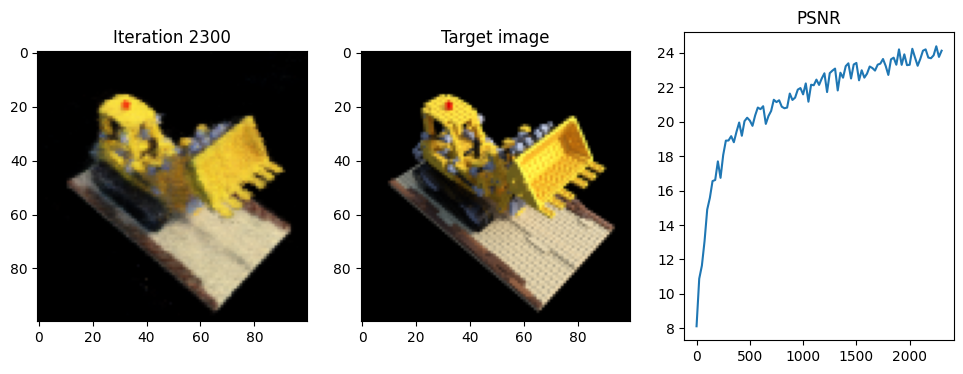

Iteration 2325  Loss: 0.0038  PSNR: 24.18  Time: 0.90 secs per iter,  34.92 mins in total


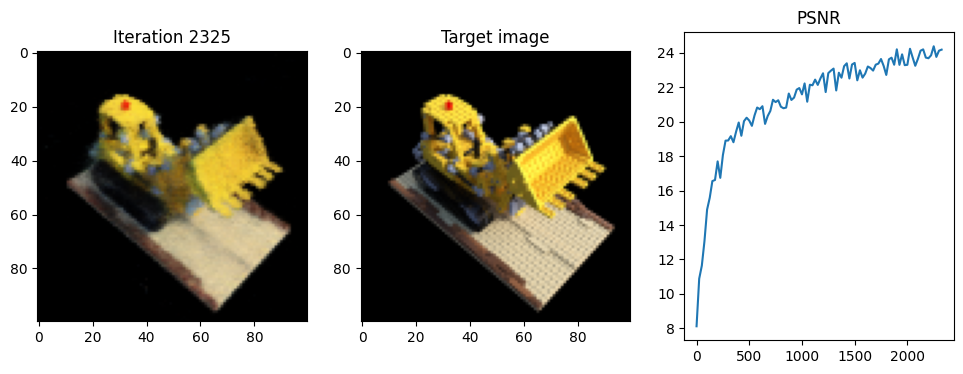

Iteration 2350  Loss: 0.0031  PSNR: 25.11  Time: 0.89 secs per iter,  35.29 mins in total


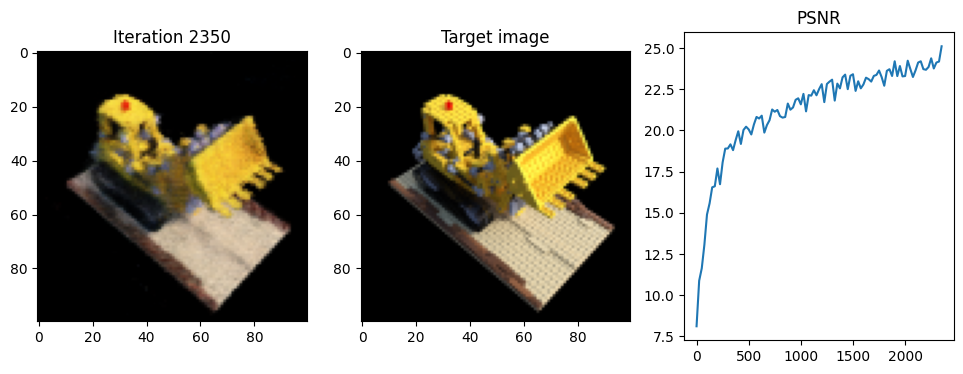

Iteration 2375  Loss: 0.0036  PSNR: 24.39  Time: 0.90 secs per iter,  35.66 mins in total


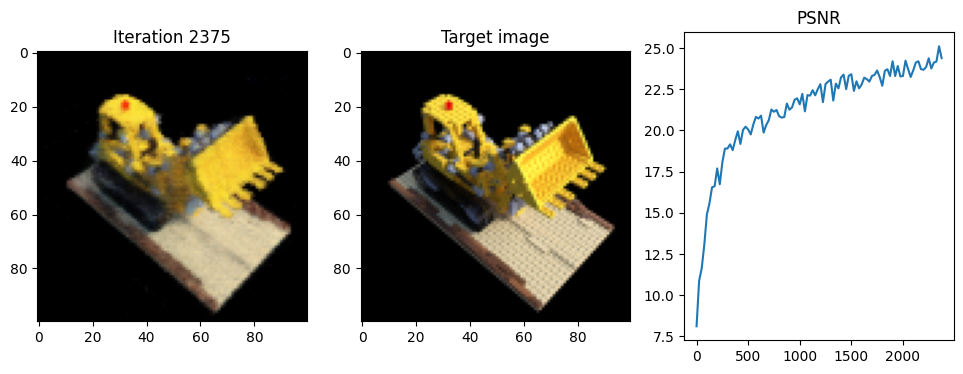

Iteration 2400  Loss: 0.0038  PSNR: 24.21  Time: 0.89 secs per iter,  36.04 mins in total


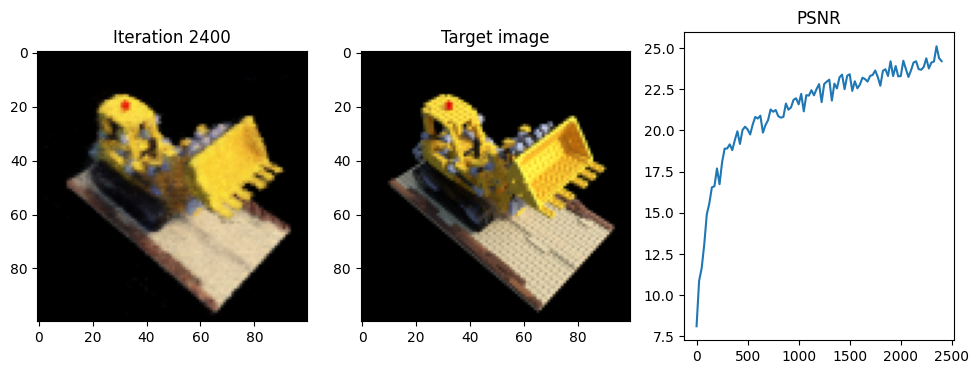

Iteration 2425  Loss: 0.0038  PSNR: 24.16  Time: 0.89 secs per iter,  36.41 mins in total


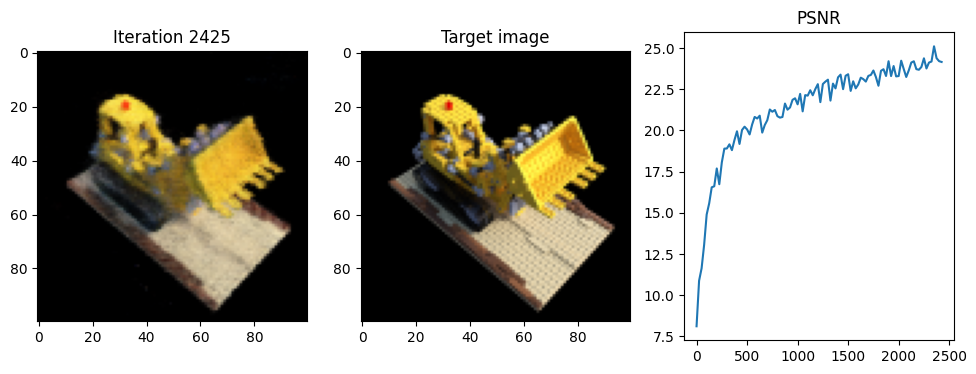

Iteration 2450  Loss: 0.0041  PSNR: 23.87  Time: 0.90 secs per iter,  36.78 mins in total


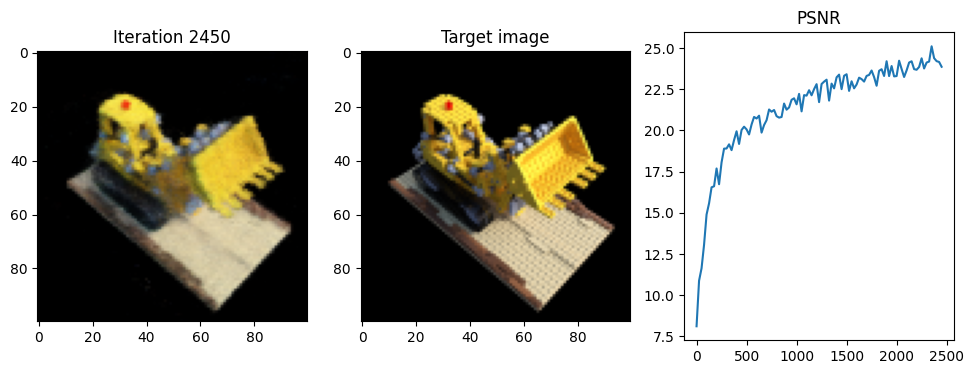

Iteration 2475  Loss: 0.0040  PSNR: 23.99  Time: 0.89 secs per iter,  37.16 mins in total


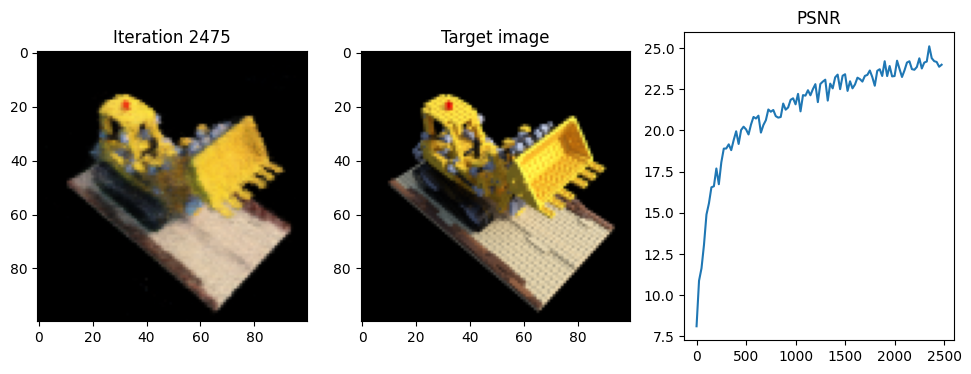

Iteration 2500  Loss: 0.0039  PSNR: 24.05  Time: 0.90 secs per iter,  37.53 mins in total


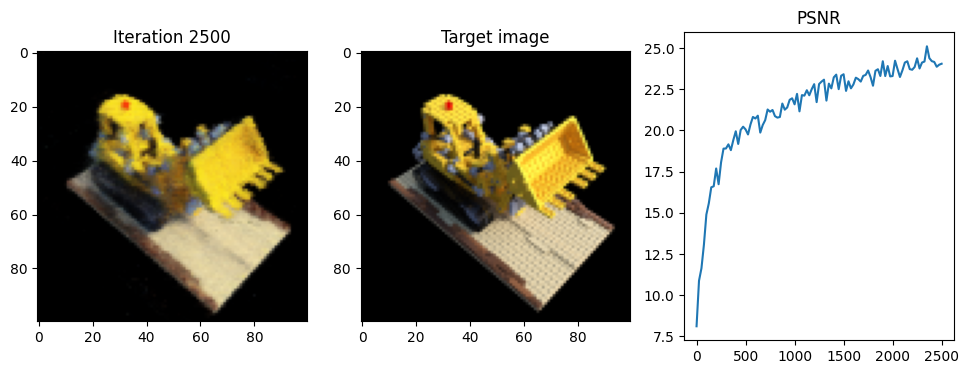

Iteration 2525  Loss: 0.0041  PSNR: 23.85  Time: 0.90 secs per iter,  37.90 mins in total


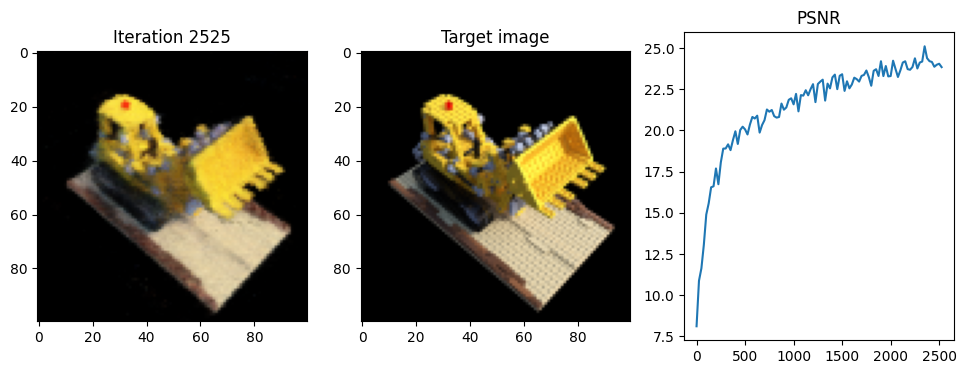

Iteration 2550  Loss: 0.0040  PSNR: 23.97  Time: 0.90 secs per iter,  38.28 mins in total


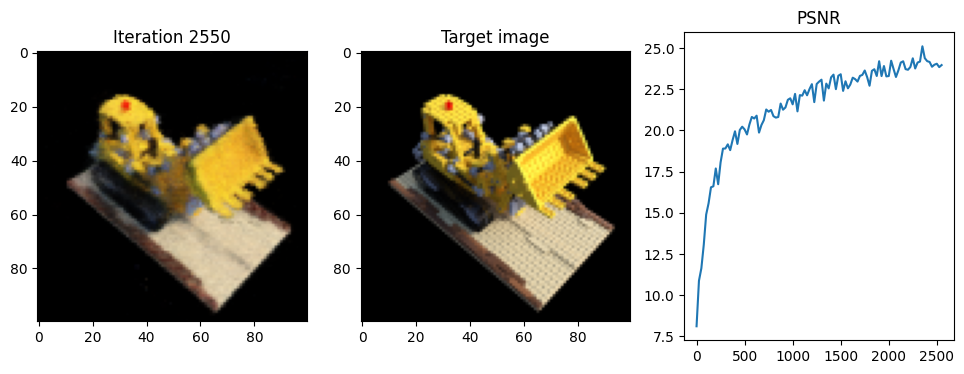

Iteration 2575  Loss: 0.0037  PSNR: 24.28  Time: 0.89 secs per iter,  38.65 mins in total


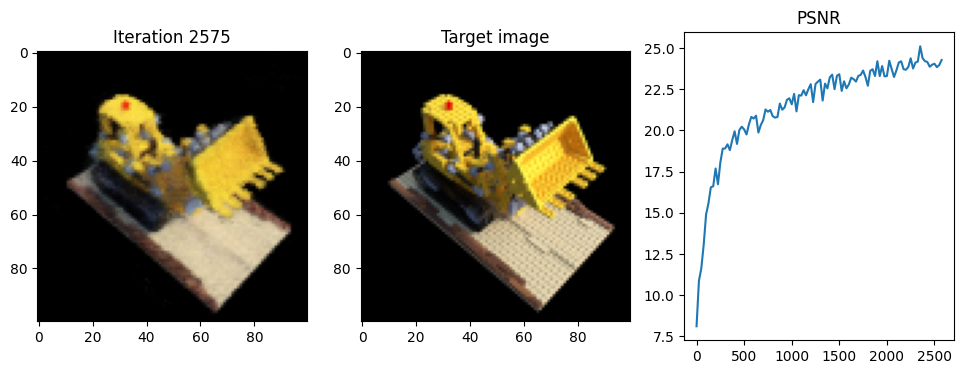

Iteration 2600  Loss: 0.0041  PSNR: 23.84  Time: 0.89 secs per iter,  39.02 mins in total


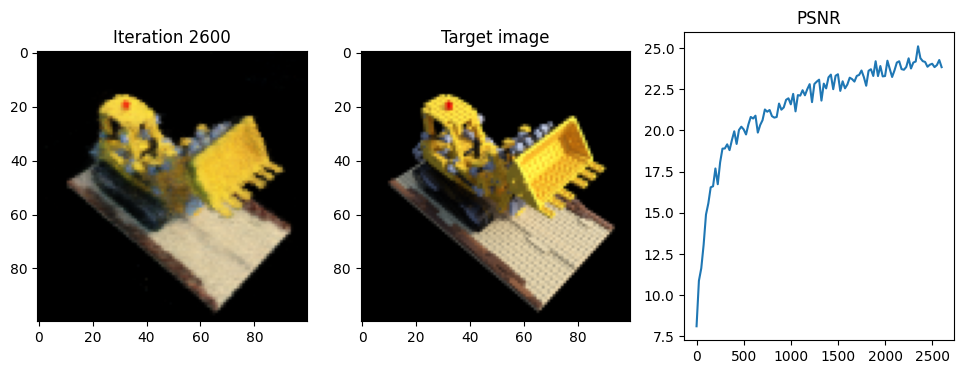

Iteration 2625  Loss: 0.0037  PSNR: 24.37  Time: 0.90 secs per iter,  39.40 mins in total


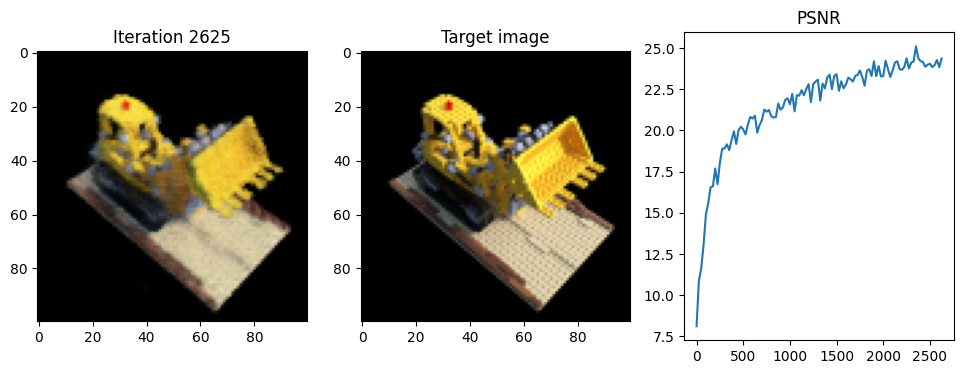

Iteration 2650  Loss: 0.0035  PSNR: 24.57  Time: 0.89 secs per iter,  39.77 mins in total


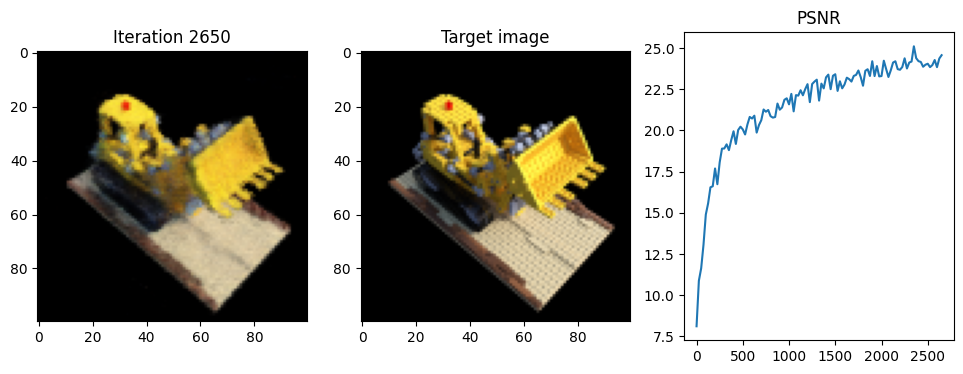

Iteration 2675  Loss: 0.0032  PSNR: 24.93  Time: 0.89 secs per iter,  40.14 mins in total


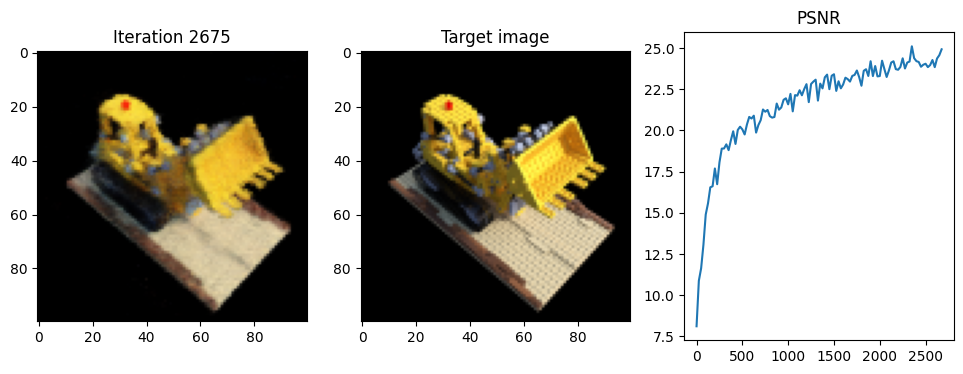

Iteration 2700  Loss: 0.0044  PSNR: 23.52  Time: 0.90 secs per iter,  40.52 mins in total


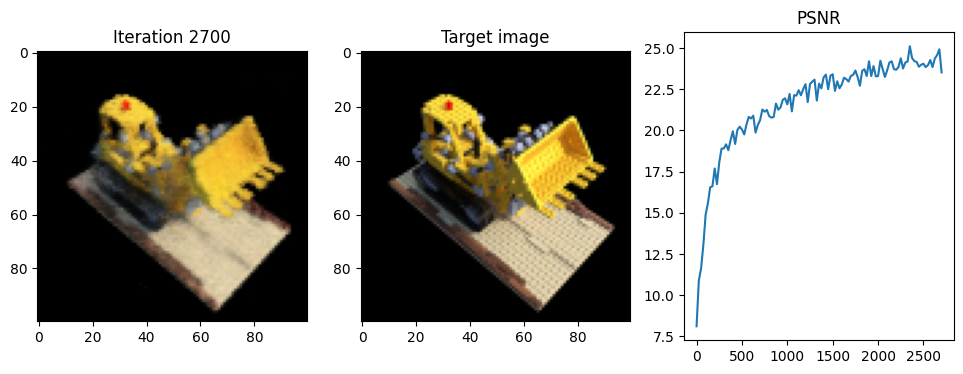

Iteration 2725  Loss: 0.0036  PSNR: 24.40  Time: 0.90 secs per iter,  40.89 mins in total


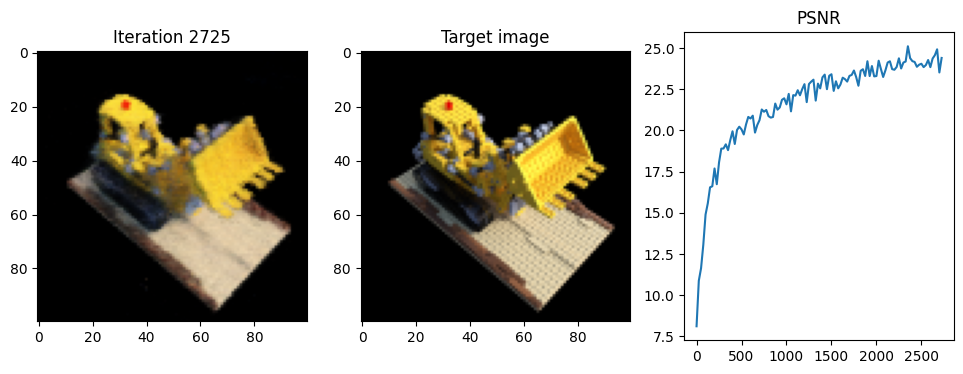

Iteration 2750  Loss: 0.0039  PSNR: 24.04  Time: 0.90 secs per iter,  41.26 mins in total


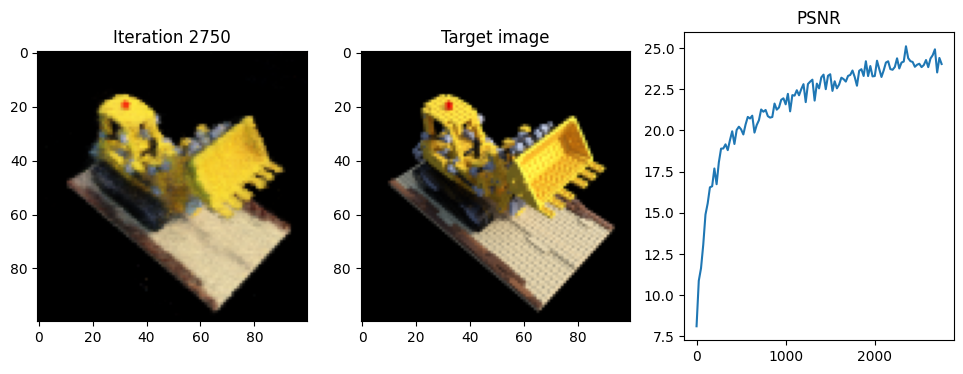

Iteration 2775  Loss: 0.0040  PSNR: 23.93  Time: 0.91 secs per iter,  41.64 mins in total


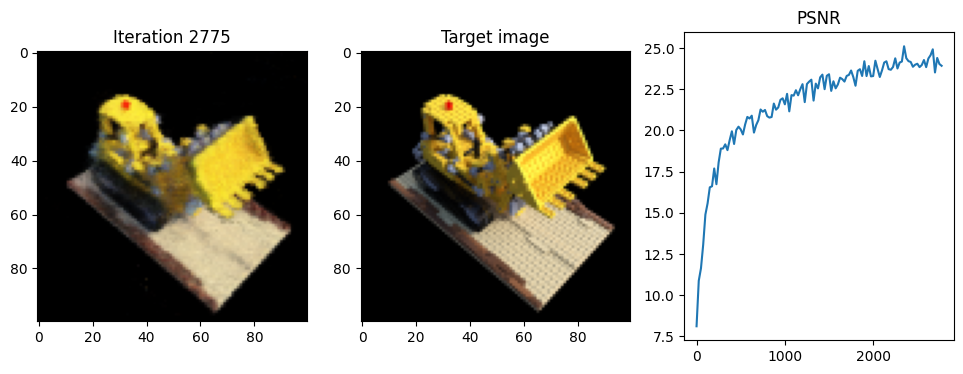

Iteration 2800  Loss: 0.0035  PSNR: 24.50  Time: 0.90 secs per iter,  42.02 mins in total


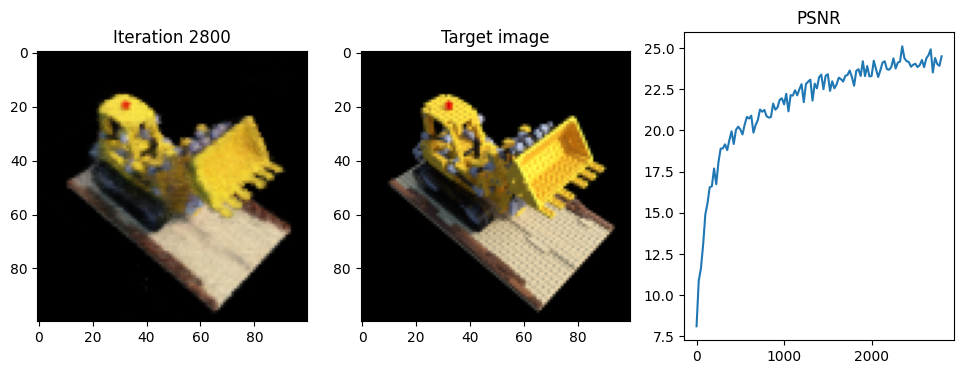

Iteration 2825  Loss: 0.0036  PSNR: 24.47  Time: 0.90 secs per iter,  42.39 mins in total


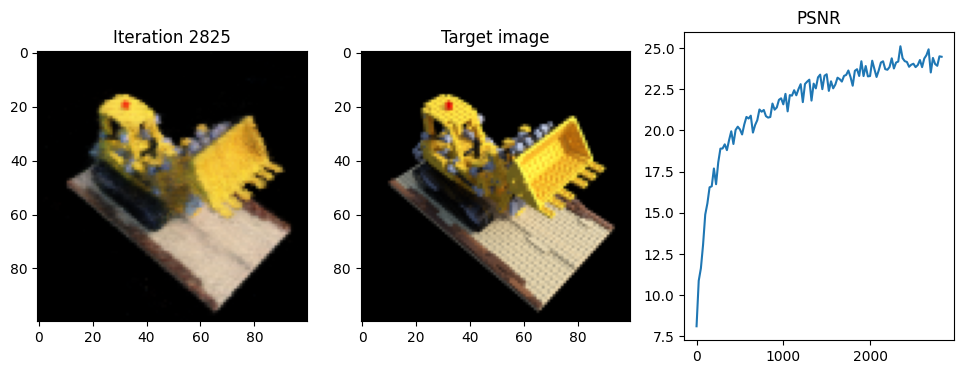

Iteration 2850  Loss: 0.0038  PSNR: 24.19  Time: 0.89 secs per iter,  42.76 mins in total


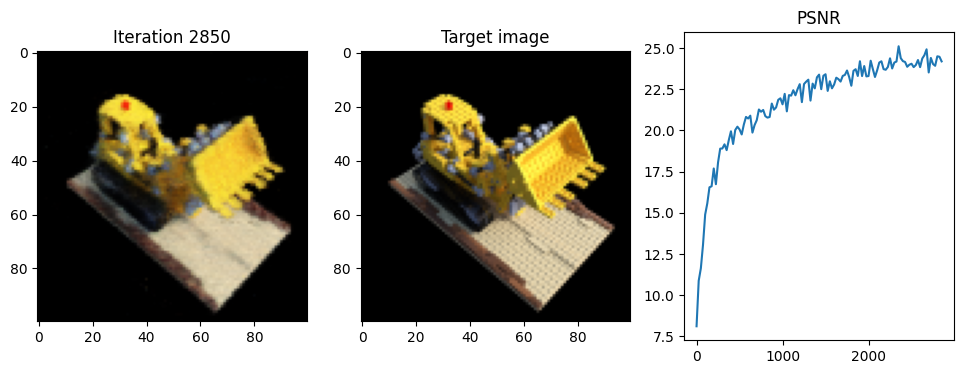

Iteration 2875  Loss: 0.0038  PSNR: 24.20  Time: 0.89 secs per iter,  43.13 mins in total


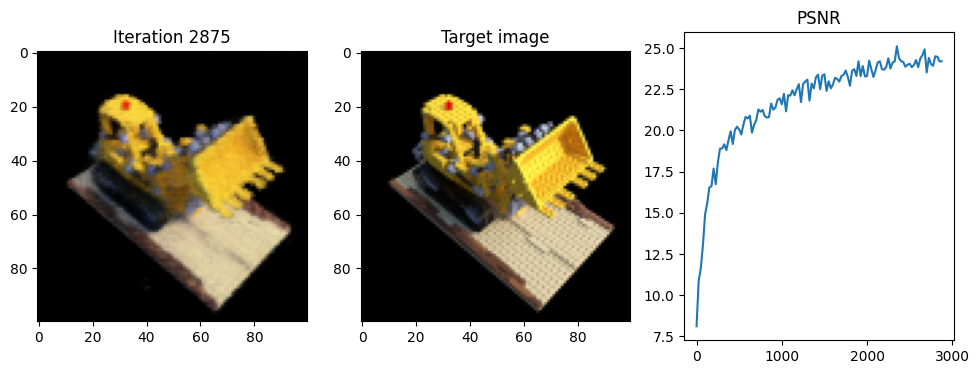

Iteration 2900  Loss: 0.0034  PSNR: 24.63  Time: 0.89 secs per iter,  43.51 mins in total


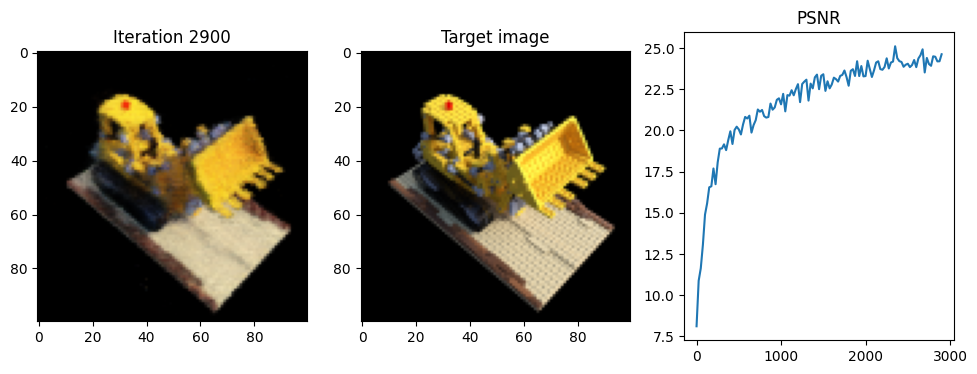

Iteration 2925  Loss: 0.0037  PSNR: 24.38  Time: 0.89 secs per iter,  43.88 mins in total


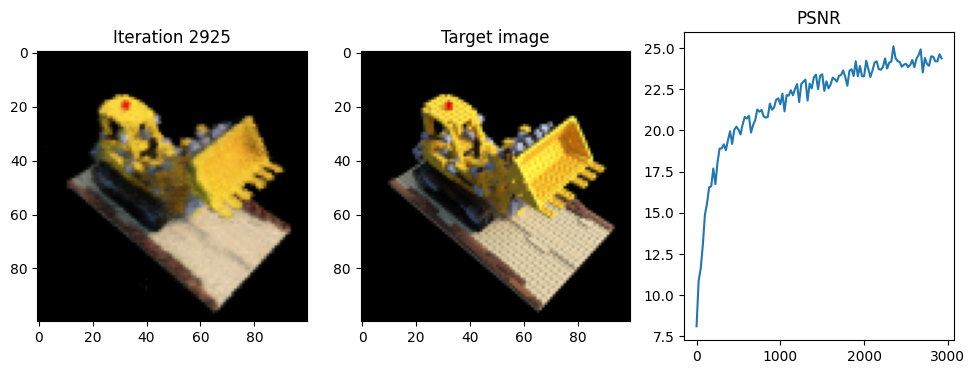

Iteration 2950  Loss: 0.0032  PSNR: 24.89  Time: 0.90 secs per iter,  44.26 mins in total


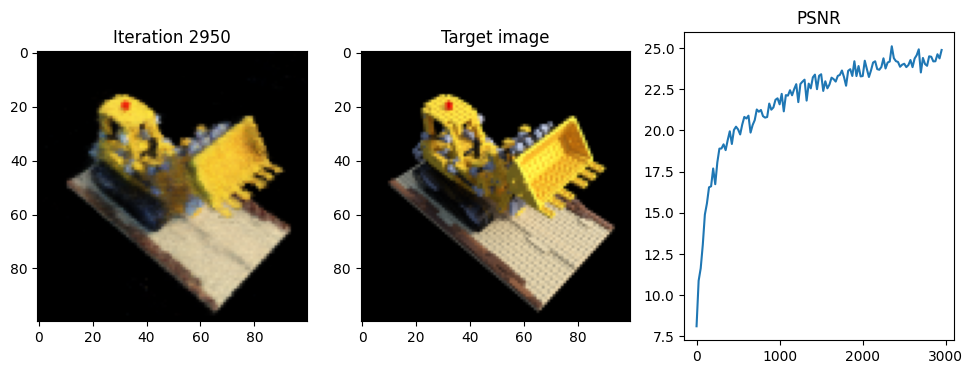

Iteration 2975  Loss: 0.0036  PSNR: 24.44  Time: 0.90 secs per iter,  44.63 mins in total


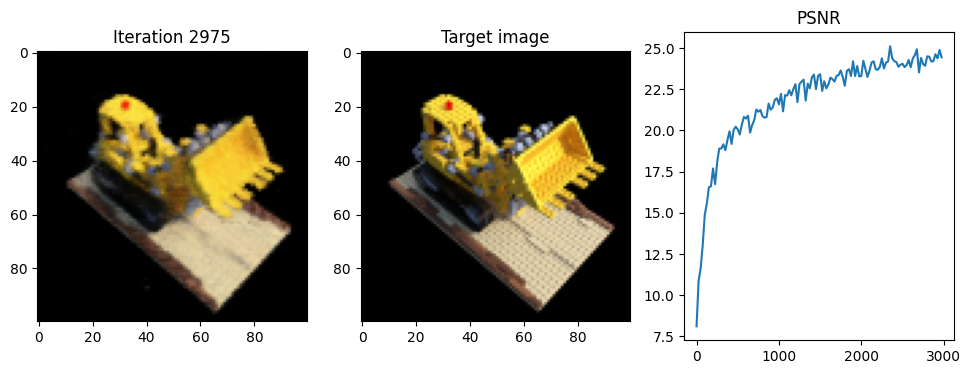

Iteration 3000  Loss: 0.0036  PSNR: 24.46  Time: 0.90 secs per iter,  45.00 mins in total


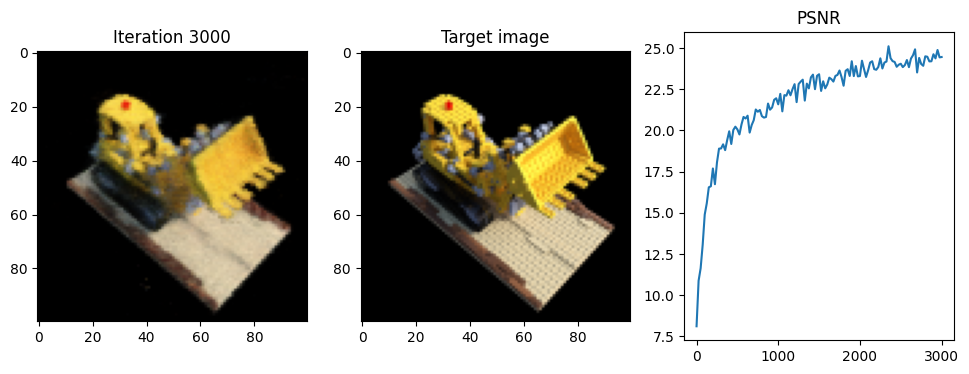

Done!


In [ ]:
for i in range(iterations+1):
    # Print the current iteration






    # Choose a random image for the forward pass
    img_idx = np.random.randint(images.shape[0])  # Randomly select an image index
    target_img = images[img_idx]  # Get the target image
    pose = poses[img_idx]  # Get the corresponding camera pose


    # Run one iteration of NeRF and get the rendered RGB image.
    rec_image = one_forward_pass(height, width, intrinsics, pose, near, far, samples, model, num_x_frequencies, num_d_frequencies)


    # Compute mean-squared error between the predicted and target images. Backprop!
    loss = F.mse_loss(rec_image, target_img)  # Calculate the loss
    loss.backward()  # Backpropagate the loss
    optimizer.step()  # Update model weights
    optimizer.zero_grad() # Clear gradients for the next iteration







    # Display images/plots/stats
    if i % display == 0:
        with torch.no_grad():

            # Render the held-out view
            # Render the held-out view
            test_rec_image = one_forward_pass(height, width, intrinsics, test_pose, near, far, samples, model, num_x_frequencies, num_d_frequencies)

            # Calculate the loss and the PSNR between the original test image and the reconstructed one.
            loss = F.mse_loss(test_rec_image, test_image)
            mse = loss.item()
            psnr = 10 * torch.log10(torch.tensor(1**2 / mse, device=device))




        print("Iteration %d " % i, "Loss: %.4f " % loss.item(), "PSNR: %.2f " % psnr.item(), \
                "Time: %.2f secs per iter, " % ((time.time() - t) / display), "%.2f mins in total" % ((time.time() - t0)/60))

        t = time.time()
        psnrs.append(psnr.item())
        iternums.append(i)

        plt.figure(figsize=(16, 4))
        plt.subplot(141)
        plt.imshow(test_rec_image.detach().cpu().numpy())
        plt.title(f"Iteration {i}")
        plt.subplot(142)
        plt.imshow(test_image.detach().cpu().numpy())
        plt.title("Target image")
        plt.subplot(143)
        plt.plot(iternums, psnrs)
        plt.title("PSNR")
        plt.show()

plt.imsave('test_lego.png',test_rec_image.detach().cpu().numpy())
torch.save(model.state_dict(),'model_nerf.pt')
print('Done!')